# (06) fast jacobian

**Motivation**: host = ```chewie```, device = ```cuda:1``` <br>

In [1]:
# HIDE CODE


import os, sys
from IPython.display import display

# tmp & extras dir
git_dir = os.path.join(os.environ['HOME'], 'Dropbox/git')
extras_dir = os.path.join(git_dir, 'jb-vae/_extras')
fig_base_dir = os.path.join(git_dir, 'jb-vae/figs')
tmp_dir = os.path.join(git_dir, 'jb-vae/tmp')

# GitHub
# sys.path.insert(0, os.path.join(git_dir, '_PoissonVAE'))
sys.path.insert(0, os.path.join(git_dir, '_IterativeVAE'))
from figures.fighelper import *
from vae.train_vae import *

# warnings, tqdm, & style
warnings.filterwarnings('ignore', category=DeprecationWarning)
warnings.filterwarnings('ignore', category=FutureWarning)
warnings.filterwarnings('ignore', category=UserWarning)
from rich.jupyter import print
%matplotlib inline
set_style()

In [2]:
from base.utils_model import load_quick
from figures.analysis import plot_convergence
from figures.imgs import plot_weights

device_idx = 1
device = f'cuda:{device_idx}'

print(f"device: {device}  ———  host: {os.uname().nodename}")

device: cuda:1  ———  host: chewie

## Poisson — Iterative

MNIST, linear decoder

### Get configs

In [3]:
model_type = 'poisson'
cfg_vae, cfg_tr = default_configs('MNIST', model_type, 'jacob|mlp')

seq_len = 4

cfg_vae['track_stats'] = True
cfg_vae['seq_len'] = seq_len

cfg_tr['kl_beta'] = 4/8 * seq_len

### Make model + trainer

In [4]:
vae = MODEL_CLASSES[model_type](CFG_CLASSES[model_type](**cfg_vae))
tr = TrainerVAE(vae, ConfigTrainVAE(**cfg_tr), device=device)

tr.n_iters

150000

### Print info

+-------------+------------+
| Module Name | Num Params |
+-------------+------------+
|    IPVAE    |  467.4 K   |
|     ———     |    ———     |
|    layer    |  467.4 K   |
+-------------+------------+

poisson_MNIST_t-4_z-[128]_<jacob|mlp>
b200-ep500-lr(0.002)_beta(2:0x0.1)_temp(0.05:lin-0.5)_gr(50)_(2024_09_14,20:31)

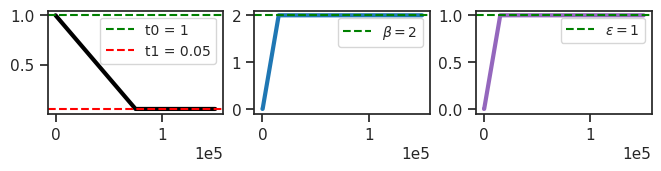

In [5]:
vae.print()
print(f"{vae.cfg.name()}\n{tr.cfg.name()}_({vae.timestamp})\n")
tr.show_schedules()

In [6]:
print_num_params(tr.model.layer)

+--------------+------------+
| Module Name  | Num Params |
+--------------+------------+
| PoissonLayer |  467.4 K   |
|     ———      |    ———     |
|     dec      |  467.1 K   |
+--------------+------------+

In [7]:
print(tr.model.layer.dec)

Sequential(
  (0): Linear(in_features=128, out_features=234, bias=True)
  (1): SiLU(inplace=True)
  (2): Linear(in_features=234, out_features=428, bias=True)
  (3): SiLU(inplace=True)
  (4): Linear(in_features=428, out_features=784, bias=True)
)

In [8]:
print(f"{vars(tr.model.cfg)}\n\n\n{vars(tr.cfg)}")

{'prior_log_dist': 'uniform', 'clamp_prior': -2, 'hard_fwd': False, 'exc_only': False, 'type': 'poisson', 'n_ch': 
32, 'seq_len': 4, 'n_latents': [128], 'jac_type': 'grad', 'enc_type': 'jacob', 'dec_type': 'mlp', 'dataset': 
'MNIST', 'input_sz': (1, 28, 28), 'res_eps': 1.0, 'clamp_u': 8.0, 'clamp_du': 7.0, 'init_dist': 'normal', 
'init_scale': 0.05, 'activation_fn': 'swish', 'fit_prior': True, 'use_bn': False, 'use_se': True, 'track_stats': 
True, 'seed': 0, 'base_dir': '/home/hadi/Projects/PoissonVAE', 'data_dir': '/home/hadi/Datasets', 'runs_dir': 
'/home/hadi/Projects/PoissonVAE/runs/poisson_MNIST_t-4_z-[128]_<jacob|mlp>', 'mods_dir': 
'/home/hadi/Projects/PoissonVAE/models/poisson_MNIST_t-4_z-[128]_<jacob|mlp>', 'results_dir': 
'/home/hadi/Projects/PoissonVAE/results'}


{'lr': 0.002, 'epochs': 500, 'batch_size': 200, 'file_name': None, 'warm_restart': 1, 'warmup_epochs': 5, 
'optimizer': 'adamax_fast', 'optimizer_kws': {'weight_decay': 0.0003, 'betas': (0.9, 0.999), 'eps': 1e-08}, 
'scheduler_type': 'cosine', 'scheduler_kws': {'T_max': 165.0, 'eta_min': 1e-05}, 'ema_rate': None, 'grad_clip': 50,
'chkpt_freq': 50, 'eval_freq': 20, 'log_freq': 10, 'method': 'mc', 'kl_beta': 2.0, 'kl_beta_min': 0.0001, 
'kl_balancer': None, 'kl_time_adjuster': None, 'kl_anneal_cycles': 0, 'kl_anneal_portion': 0.1, 'kl_const_portion':
0.001, 'temp_anneal_portion': 0.5, 'temp_anneal_type': 'lin', 'temp_start': 1.0, 'temp_stop': 0.05}

### Fit model

In [9]:
tr.train()

epoch # 500, avg loss: 24.885482: 100%|███████| 500/500 [41:49<00:00,  5.02s/it]


**Task:** MNIST, MLP, $(T, \beta) = (4, 2.0)$,

- Done: MNIST, MLP, $(T, \beta) = (2, 1.0)$, converge? Nope, diverged.

In [10]:
print(vae.layer.n_exp)

tensor([21, 33, 38, 40], device='cuda:1', dtype=torch.int32)

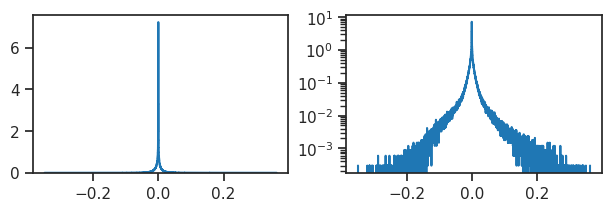

In [11]:
w = tonp(tr.model.layer.get_weight().ravel())

fig, axes = create_figure(1, 2, sharex='all')
for ax in axes.flat:
    sns.histplot(
        w, 
        stat='percent',
        element='step',
        fill=False,
        label=r"$\Phi$",
        color="C0",
        ax=ax,
    )
    ax.set(ylabel='')
axes[1].set(yscale='log')

plt.show()

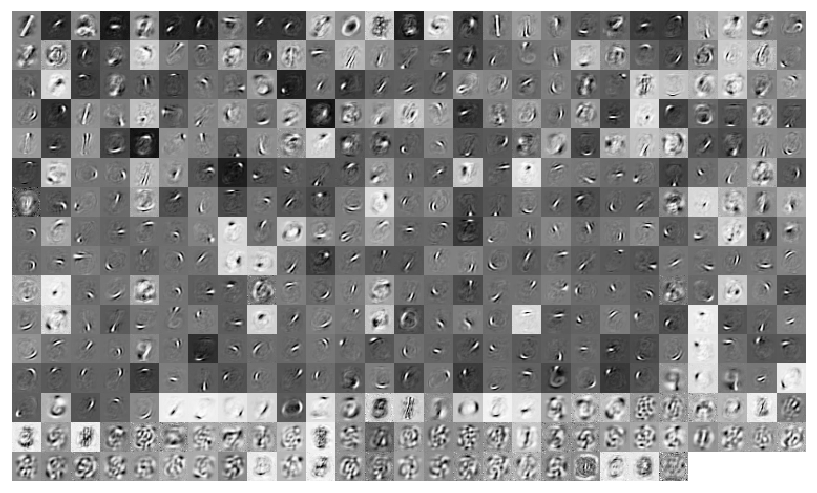

In [12]:
w = tr.model.layer.get_weight()
norms = tonp(torch.linalg.vector_norm(w, dim=1))
tr.model.show(order=np.argsort(norms), dpi=120, pad=0);

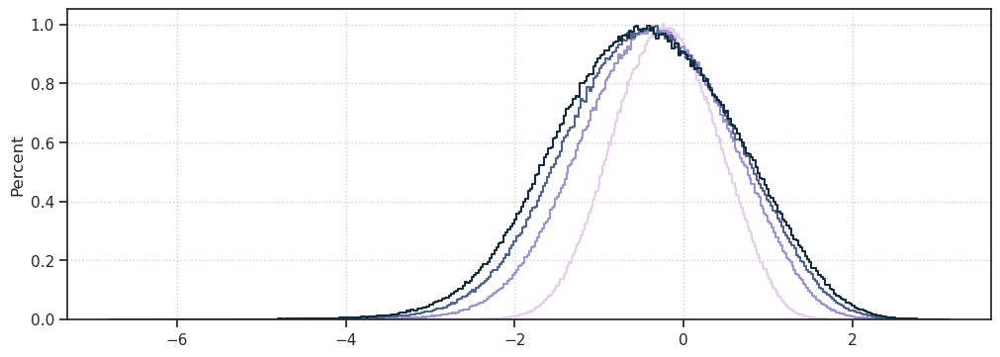

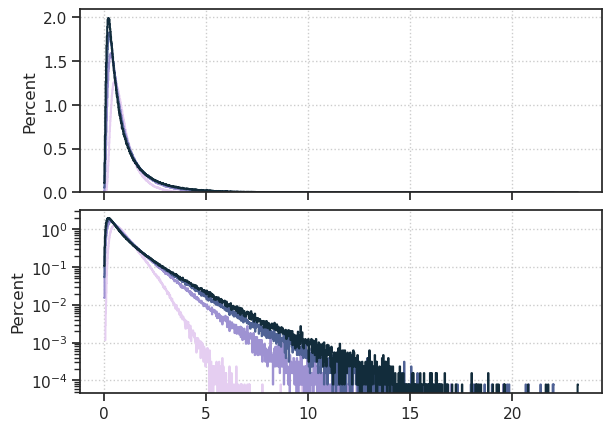

In [13]:
posterior_log_rates = collections.defaultdict(list)
for x, *_ in iter(tr.dl_vld):
    output = tr.model.xtract_ftr(x)
    for t, pois in output['dist'].items():
        posterior_log_rates[t].append(torch.log(pois.rate))
posterior_log_rates = {
    t: tonp(torch.cat(v)) for t, v
    in posterior_log_rates.items()
}


fig, ax = create_figure(1, 1, (10, 3.5))
pal = get_cubehelix_palette(tr.model.cfg.seq_len, start=2.5)

for i, (t, v) in enumerate(posterior_log_rates.items()):
    sns.histplot(
        v.ravel(),
        stat='percent',
        element='step',
        fill=False,
        color=pal[i],
        label=f"T = {t}",
        ax=ax,
    )
# ax.legend()
ax.grid()
plt.show()


fig, axes = create_figure(2, 1, (6, 4.2), sharex='col')
for i, (t, v) in enumerate(posterior_log_rates.items()):
    for ax in axes.flat:
        sns.histplot(
            np.exp(v.ravel()),
            stat='percent',
            element='step',
            fill=False,
            color=pal[i],
            label=f"T = {t}",
            ax=ax,
        )
axes[1].set(yscale='log')
add_grid(axes)
plt.show()

In [14]:
pal

[[0.8975507056831679, 0.8094812603307622, 0.9465577040964425],
 [0.621433610824204, 0.5738491579616475, 0.8244120665462615],
 [0.3090934491249027, 0.3854178083786437, 0.5835384610223103],
 [0.07235872150128392, 0.17287618251766537, 0.23013648857700542]]

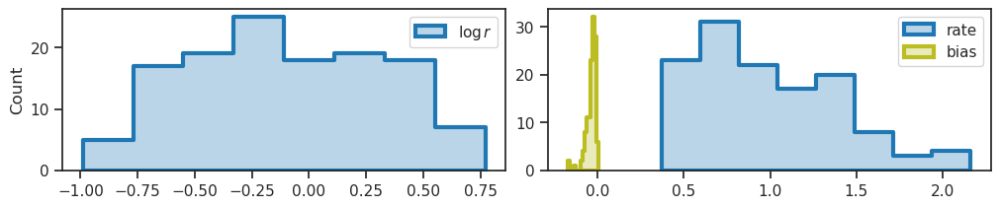

In [15]:
log_rate = tonp(tr.model.layer.log_rate).ravel()
bias = tonp(tr.model.layer.bias).ravel()

fig, axes = create_figure(1, 2, (10, 2))
kws = dict(fill=True, lw=3, alpha=0.3, ax=axes[0])
sns.histplot(log_rate, color='C0', element='step', label=r'$\log r$', **kws)

kws = dict(fill=True, lw=3, alpha=0.3, ax=axes[1])
sns.histplot(np.exp(log_rate), color='C0', element='step', label='rate', **kws)
sns.histplot(bias, color='C8', element='step', label='bias', **kws)

axes[1].set(ylabel='')
add_legend(axes)

plt.show()

In [16]:
dead = log_rate > 1.1
dead.sum(), (~dead).sum(), dead.sum() / len(dead)

(0, 128, 0.0)

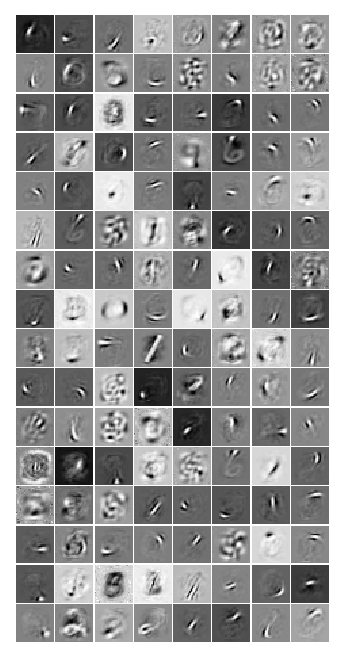

In [17]:
tr.model.show(order=np.argsort(log_rate));

100%|█████████████████████████████████| 50/50 [01:39<00:00,  2.00s/it]


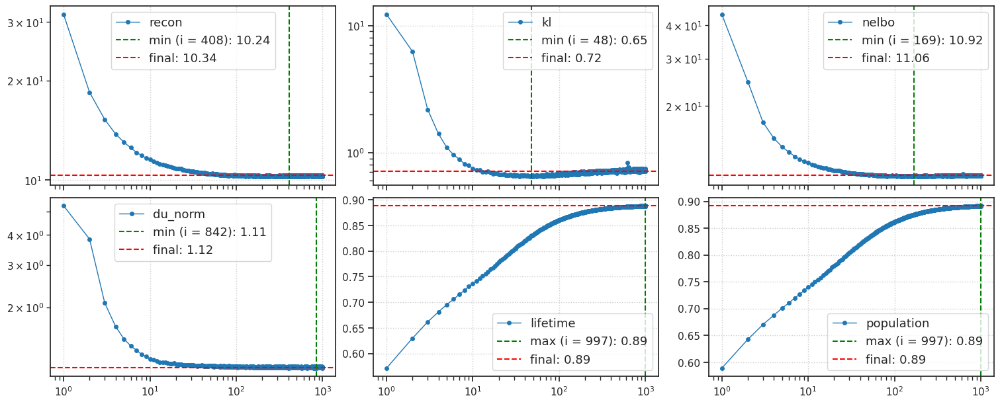

CPU times: user 1min 41s, sys: 2.1 s, total: 1min 43s
Wall time: 1min 42s


In [18]:
%%time

kws = dict(
    seq_total=1000,
    seq_batch_sz=1000,
    n_data_batches=None,
    active=~dead,
)
results = tr.analysis('vld', **kws)
_ = plot_convergence(results, color='C0')

Final gold standard, using ```clamp_du = 7.0``` with:

$T = 10, \quad \beta = 5.0, \quad$

100%|█████████████████████████████████| 50/50 [24:28<00:00, 29.38s/it]


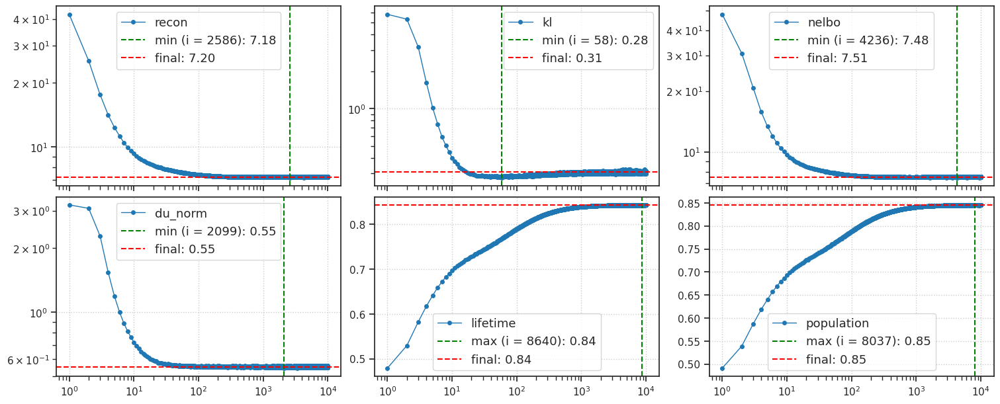

CPU times: user 24min 24s, sys: 20 s, total: 24min 44s
Wall time: 24min 42s


In [20]:
## Was: gold standard, MLP

In [ ]:
u_max = np.array(tr.model.stats['u_max'])
du_max = np.array(tr.model.stats['du_max'])

fig, ax = create_figure()
ax.plot(u_max, color='k', label='u', lw=0.2)
ax.plot(du_max, color='r', label='du', alpha=0.7, lw=0.2)
ax.legend()
plt.show()

In [ ]:
fig, ax = create_figure()
ax.plot(u_max[-len(u_max) // 3:], color='k', label='u', lw=0.2)
ax.plot(du_max[-len(u_max) // 3:], color='r', label='du', alpha=0.7, lw=0.2)
ax.legend()
plt.show()

In [ ]:
ax = sns.histplot(tonp(tr.model.state.exp().ravel()), element='step', fill=False)
ax.set_yscale('log');

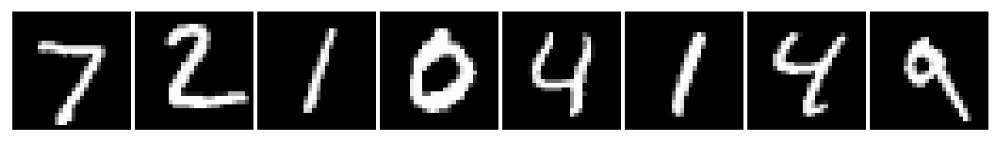

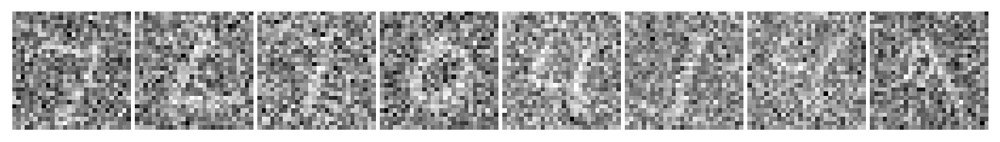

In [71]:
x = next(iter(tr.dl_vld))[0][:8]
x_noisy = x + torch.randn_like(x) * 0.7

_ = plot_weights(tonp(x.squeeze()), nrows=1)
_ = plot_weights(tonp(x_noisy.squeeze()), nrows=1)

In [72]:
tr.model.reset_state(len(x))
tr.model.reset_pred()

output = tr.model(x_noisy, seq=range(300))
output = output.stack()

In [78]:
sample_i = 1

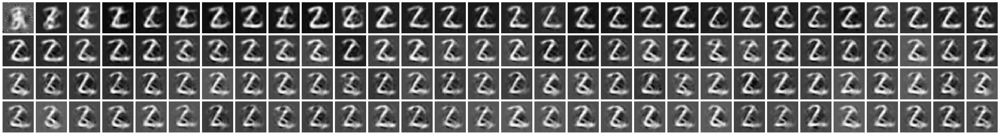

In [79]:
nrows, ncols = 4, 30
fig, axes = create_figure(nrows, ncols, (1.3 * ncols, 1.3 * nrows), 'all', 'all')
for idx, ax in enumerate(axes.flat):
    i, j = idx // ncols, idx % ncols
    x2p = tonp(output['recon'][sample_i, idx].reshape(shape))
    ax.imshow(x2p, cmap='Greys_r')
remove_ticks(axes)

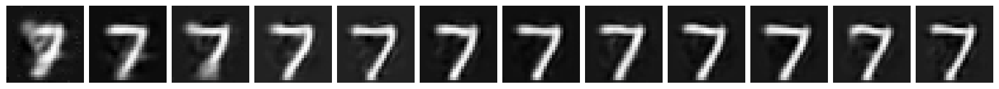

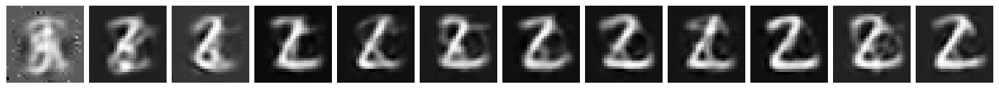

In [80]:
nrows, ncols = 1, 12
fig, axes = create_figure(nrows, ncols, (1.3 * ncols, 1.3 * nrows), 'all', 'all')
for idx, ax in enumerate(axes.flat):
    i, j = idx // ncols, idx % ncols
    x2p = tonp(output['recon'][sample_i, idx].reshape(shape))
    ax.imshow(x2p, cmap='Greys_r')
remove_ticks(axes)

## Poisson — Amortized

In [3]:
model_type = 'poisson'
cfg_vae, cfg_tr = default_configs('MNIST', model_type, 'mlp|mlp')

cfg_vae['track_stats'] = True
cfg_vae['seq_len'] = 1

vae = MODEL_CLASSES[model_type](CFG_CLASSES[model_type](**cfg_vae))
tr = TrainerVAE(vae, ConfigTrainVAE(**cfg_tr), device=device)

In [15]:
print(f"{vae.cfg.name()}\n{tr.cfg.name()}_({vae.timestamp})\n")

poisson_MNIST_t-1_z-[128]_<mlp|mlp>
b200-ep500-lr(0.002)_beta(1:0x0.1)_temp(0.05:lin-0.5)_gr(50)_(2024_09_13,17:45)

In [4]:
tr.train()

epoch # 500, avg loss: 33.854328: 100%|███████| 500/500 [12:30<00:00,  1.50s/it]


In [9]:
data, loss, etc = tr.validate()
loss = {
    k: v.mean(0) for k, v in
    loss.items() if k!= 'kl_diag'
}
print(loss)

{
    'kl': array([10.437049], dtype=float32),
    'recon': array([24.48348], dtype=float32),
    'nelbo': array([34.920532], dtype=float32)
}

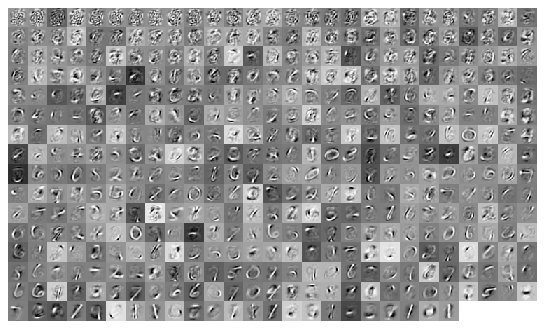

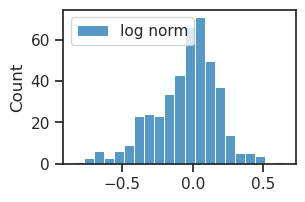

In [19]:
w = tr.model.layer.get_weight()
norms = tonp(torch.linalg.vector_norm(w, dim=1))

_ = tr.model.show(order=np.argsort(norms), dpi=80, pad=0)

sns.histplot(np.log(norms), label='log norm')
plt.legend()
plt.show()

## Poisson — Iterative

### Get configs

In [3]:
model_type = 'poisson'
cfg_vae, cfg_tr = default_configs('MNIST', model_type, 'jacob|mlp')

cfg_vae['track_stats'] = True
cfg_vae['seq_len'] = 10
cfg_vae['clamp_du'] = 7

cfg_tr['kl_beta'] = 5.0

### Make model + trainer

In [4]:
vae = MODEL_CLASSES[model_type](CFG_CLASSES[model_type](**cfg_vae))
tr = TrainerVAE(vae, ConfigTrainVAE(**cfg_tr), device=device)

tr.n_iters

150000

### Print info

+-------------+------------+
| Module Name | Num Params |
+-------------+------------+
|    IPVAE    |  467.4 K   |
|     ———     |    ———     |
|    layer    |  467.4 K   |
+-------------+------------+

poisson_uniform_c(-2)_MNIST_t-10_z-[128]_<jacob|mlp+b>
b200-ep500-lr(0.002)_beta(5:0x0.1)_temp(0.05:lin-0.5)_gr(100)_(2024_09_12,10:56)

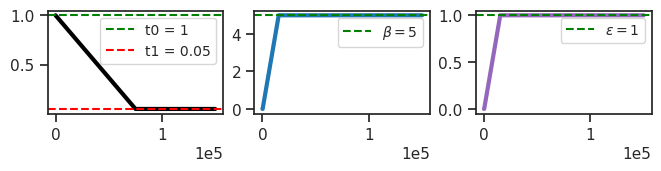

In [5]:
vae.print()
print(f"{vae.cfg.name()}\n{tr.cfg.name()}_({vae.timestamp})\n")
tr.show_schedules()

In [6]:
print_num_params(tr.model.layer)

+--------------+------------+
| Module Name  | Num Params |
+--------------+------------+
| PoissonLayer |  467.4 K   |
|     ———      |    ———     |
|     dec      |  467.1 K   |
+--------------+------------+

In [37]:
print(tr.model.layer.dec)

Sequential(
  (0): Linear(in_features=128, out_features=234, bias=True)
  (1): SiLU(inplace=True)
  (2): Linear(in_features=234, out_features=428, bias=True)
  (3): SiLU(inplace=True)
  (4): Linear(in_features=428, out_features=784, bias=True)
)

In [8]:
print(f"{vars(tr.model.cfg)}\n\n\n{vars(tr.cfg)}")

{'prior_log_dist': 'uniform', 'prior_clamp': -2, 'hard_fwd': False, 'exc_only': False, 'type': 'poisson', 'n_ch': 
32, 'seq_len': 10, 'n_latents': [128], 'lateral_ker_sz': [None], 'jac_type': 'grad', 'enc_type': 'jacob', 
'dec_type': 'mlp', 'enc_bias': False, 'dec_bias': True, 'enc_norm': False, 'dec_norm': False, 'dataset': 'MNIST', 
'input_sz': (1, 28, 28), 'res_eps': 1.0, 'clamp_u': 8.0, 'clamp_du': 7, 'init_dist': 'normal', 'init_scale': 0.05, 
'activation_fn': 'swish', 'fit_prior': True, 'use_bn': False, 'use_se': True, 'track_stats': True, 'seed': 0, 
'base_dir': '/home/hadi/Projects/PoissonVAE', 'data_dir': '/home/hadi/Datasets', 'runs_dir': 
'/home/hadi/Projects/PoissonVAE/runs/poisson_uniform_c(-2)_MNIST_t-10_z-[128]_<jacob|mlp+b>', 'mods_dir': 
'/home/hadi/Projects/PoissonVAE/models/poisson_uniform_c(-2)_MNIST_t-10_z-[128]_<jacob|mlp+b>', 'results_dir': 
'/home/hadi/Projects/PoissonVAE/results'}


{'lr': 0.002, 'epochs': 500, 'batch_size': 200, 'file_name': None, 'warm_restart': 1, 'warmup_epochs': 5, 
'optimizer': 'adamax_fast', 'optimizer_kws': {'weight_decay': 0.0003, 'betas': (0.9, 0.999), 'eps': 1e-08}, 
'scheduler_type': 'cosine', 'scheduler_kws': {'T_max': 165.0, 'eta_min': 1e-05}, 'ema_rate': None, 'grad_clip': 
100, 'chkpt_freq': 50, 'eval_freq': 20, 'log_freq': 10, 'use_amp': False, 'method': 'mc', 'kl_beta': 5.0, 
'kl_beta_min': 0.0001, 'kl_balancer': None, 'kl_time_adjuster': None, 'kl_anneal_cycles': 0, 'kl_anneal_portion': 
0.1, 'kl_const_portion': 0.001, 'lambda_anneal': False, 'lambda_init': 0.0, 'lambda_norm': 0.0, 
'temp_anneal_portion': 0.5, 'temp_anneal_type': 'lin', 'temp_start': 1.0, 'temp_stop': 0.05}

### Fit model

In [9]:
tr.train(f"u:({tr.model.cfg.clamp_u})-du:({tr.model.cfg.clamp_du})_{tr.cfg.name()}")

epoch # 500, avg loss: 18.174711: 100%|█████| 500/500 [2:02:46<00:00, 14.73s/it]


Task: does clamp_du = 7.0 reproduce gold standard?

In [35]:
print(vae.layer.n_exp)

tensor([17, 25, 35, 41, 45, 47, 49, 51, 52, 53], device='cuda:1',
       dtype=torch.int32)

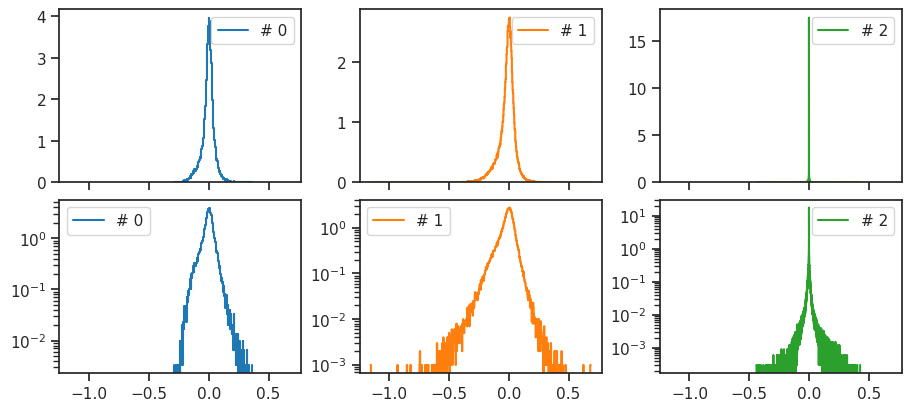

In [36]:
linear_layers = list(filter(
    lambda m: hasattr(m, 'weight'),
    tr.model.layer.dec,
))

fig, axes = create_figure(2, len(linear_layers), sharex='all')
for i, m in enumerate(linear_layers):
    if hasattr(m, 'weight'):
        w = m.weight.data
    for ax in axes[:, i]:
        sns.histplot(
            tonp(w.ravel()), 
            stat='percent',
            element='step',
            fill=False,
            label=f"# {i}",
            color=f"C{i}",
            ax=ax,
        )
    axes[0, i].set(yscale='linear', ylabel='')
    axes[1, i].set(yscale='log', ylabel='')
add_legend(axes)
plt.show()

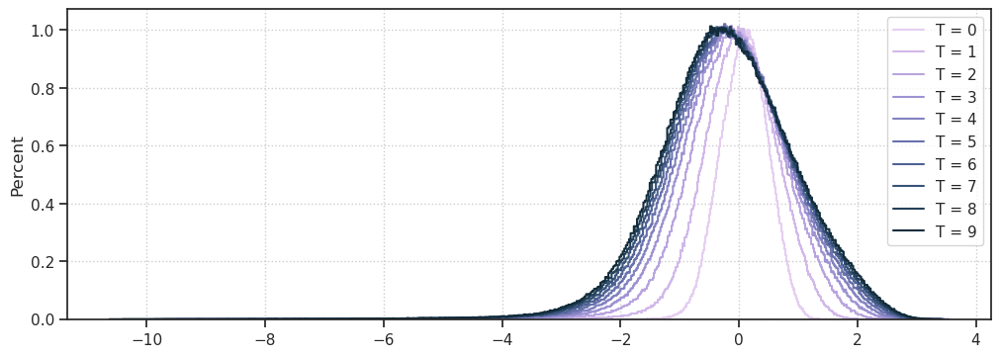

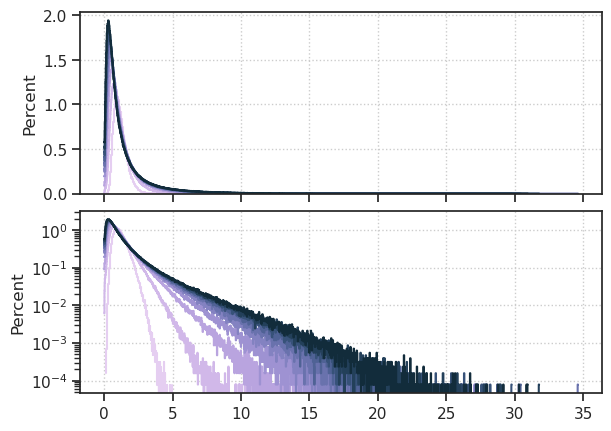

In [13]:
posterior_log_rates = collections.defaultdict(list)
for x, *_ in iter(tr.dl_vld):
    output = tr.model.xtract_ftr(x)
    for t, pois in output['dist'].items():
        posterior_log_rates[t].append(torch.log(pois.rate))
posterior_log_rates = {
    t: tonp(torch.cat(v)) for t, v
    in posterior_log_rates.items()
}


fig, ax = create_figure(1, 1, (10, 3.5))
pal = get_cubehelix_palette(tr.model.cfg.seq_len, start=2.5)

for i, (t, v) in enumerate(posterior_log_rates.items()):
    sns.histplot(
        v.ravel(),
        stat='percent',
        element='step',
        fill=False,
        color=pal[i],
        label=f"T = {t}",
        ax=ax,
    )
ax.legend()
ax.grid()
plt.show()


fig, axes = create_figure(2, 1, (6, 4.2), sharex='col')
for i, (t, v) in enumerate(posterior_log_rates.items()):
    for ax in axes.flat:
        sns.histplot(
            np.exp(v.ravel()),
            stat='percent',
            element='step',
            fill=False,
            color=pal[i],
            label=f"T = {t}",
            ax=ax,
        )
axes[1].set(yscale='log')
add_grid(axes)
plt.show()

In [14]:
pal

[[0.8975507056831679, 0.8094812603307622, 0.9465577040964425],
 [0.8178323483750889, 0.7228373334284097, 0.9156857084467959],
 [0.7243842279061081, 0.6447757533596252, 0.8762257510361532],
 [0.621433610824204, 0.5738491579616475, 0.8244120665462615],
 [0.5137602016853071, 0.5080741960907603, 0.7578471038208457],
 [0.41165859076399486, 0.44819771588937396, 0.6800995692970601],
 [0.3090934491249027, 0.3854178083786437, 0.5835384610223103],
 [0.2159918198929715, 0.32026582325789205, 0.4738907509899629],
 [0.13614552585465997, 0.2501791993868458, 0.35455980691569594],
 [0.07235872150128392, 0.17287618251766537, 0.23013648857700542]]

In [3]:
# model_name = 'poisson_uniform_c(-2)_MNIST_t-10_z-[128]_k-32_<jacob|mlp+b>'
# fit_name = 'nexp-per-time-1e-6_b200-ep500-lr(0.002)_beta(5:0x0.5)_temp(0.05:lin-0.5)_gr(1000)_(2024_09_09,20:44)'
# tr, meta = load_model(model_name, fit_name, device=device)
# meta['checkpoint']

500

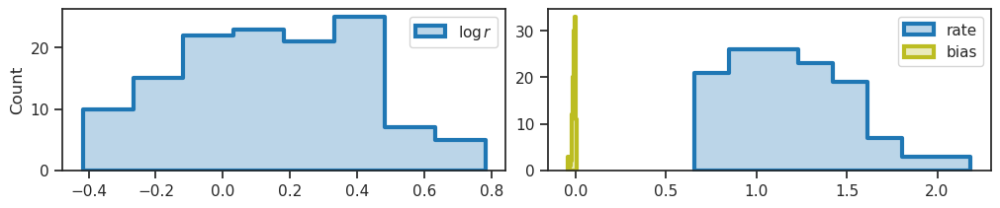

In [15]:
log_rate = tonp(tr.model.layer.log_rate).ravel()
bias = tonp(tr.model.layer.bias).ravel()

fig, axes = create_figure(1, 2, (10, 2))
kws = dict(fill=True, lw=3, alpha=0.3, ax=axes[0])
sns.histplot(log_rate, color='C0', element='step', label=r'$\log r$', **kws)

kws = dict(fill=True, lw=3, alpha=0.3, ax=axes[1])
sns.histplot(np.exp(log_rate), color='C0', element='step', label='rate', **kws)
sns.histplot(bias, color='C8', element='step', label='bias', **kws)

axes[1].set(ylabel='')
add_legend(axes)

plt.show()

In [16]:
dead = log_rate < -2
dead.sum(), (~dead).sum(), dead.sum() / len(dead)

(0, 128, 0.0)

Final gold standard, using ```clamp_du = 7.0``` with:

$T = 10, \quad \beta = 5.0, \quad$

100%|█████████████████████████████████| 50/50 [24:28<00:00, 29.38s/it]


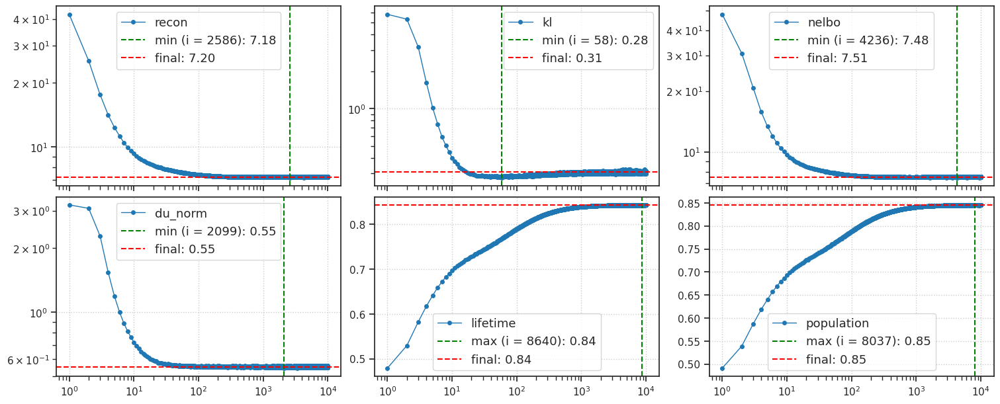

CPU times: user 24min 24s, sys: 20 s, total: 24min 44s
Wall time: 24min 42s


In [20]:
%%time

kws = dict(
    seq_total=10000,
    seq_batch_sz=1000,
    n_data_batches=None,
)
results = tr.analysis(dl_name='vld', **kws)
_ = plot_convergence(results, color='C0')

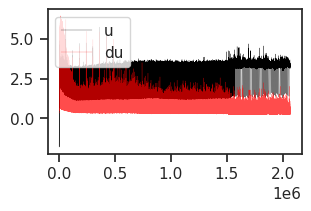

In [24]:
u_max = np.array(tr.model.stats['u_max'])
du_max = np.array(tr.model.stats['du_max'])

fig, ax = create_figure()
ax.plot(u_max, color='k', label='u', lw=0.2)
ax.plot(du_max, color='r', label='du', alpha=0.7, lw=0.2)
ax.legend()
plt.show()

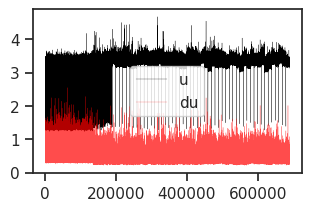

In [27]:
fig, ax = create_figure()
ax.plot(u_max[-len(u_max) // 3:], color='k', label='u', lw=0.2)
ax.plot(du_max[-len(u_max) // 3:], color='r', label='du', alpha=0.7, lw=0.2)
ax.legend()
plt.show()

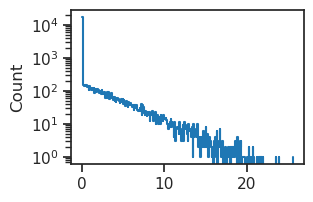

In [34]:
ax = sns.histplot(tonp(tr.model.state.exp().ravel()), element='step', fill=False)
ax.set_yscale('log');

Below almost better than gold standard, with:

$T = 16, \quad \beta = 8.0, \quad$

100%|█████████████████████████████████| 50/50 [24:29<00:00, 29.40s/it]


______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

vld

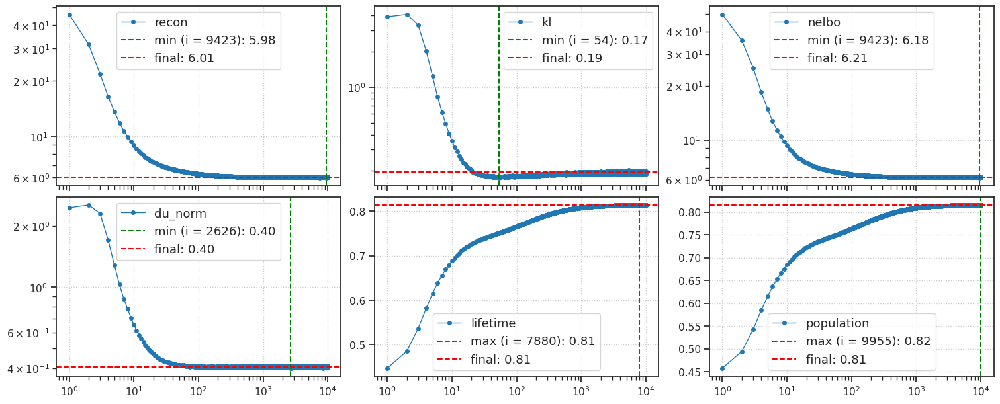

CPU times: user 24min 25s, sys: 19.6 s, total: 24min 45s
Wall time: 24min 43s


In [23]:
%%time

kws = dict(
    seq_total=10000,
    seq_batch_sz=1000,
    n_data_batches=None,
    # active=~dead,
)
results = {
    name: tr.analysis(dl_name=name, **kws)
    for name in  ['vld'] # 'trn'] # , 'tst']
}

colors = {'trn': 'C9', 'vld': 'C0', 'tst': 'k'}
for name, d in results.items():
    print('_' * 110)
    print('-' * 110)
    print(name)

    plot_convergence(d, color=colors[name])

______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

vld

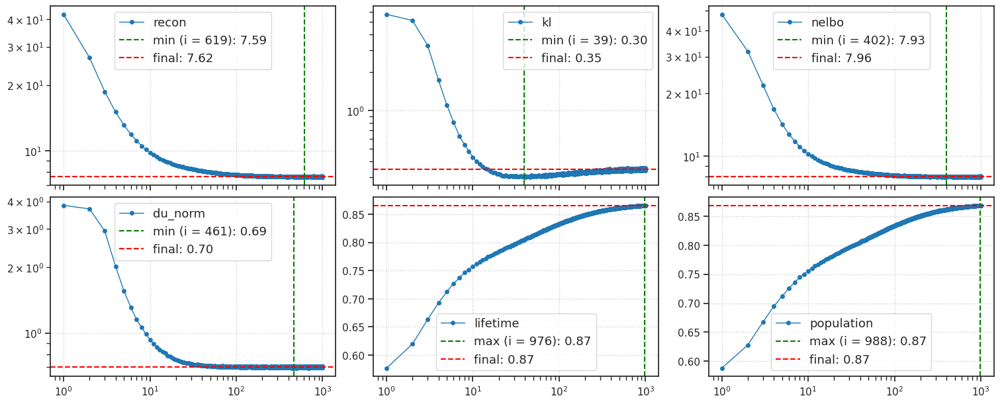

______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

vld

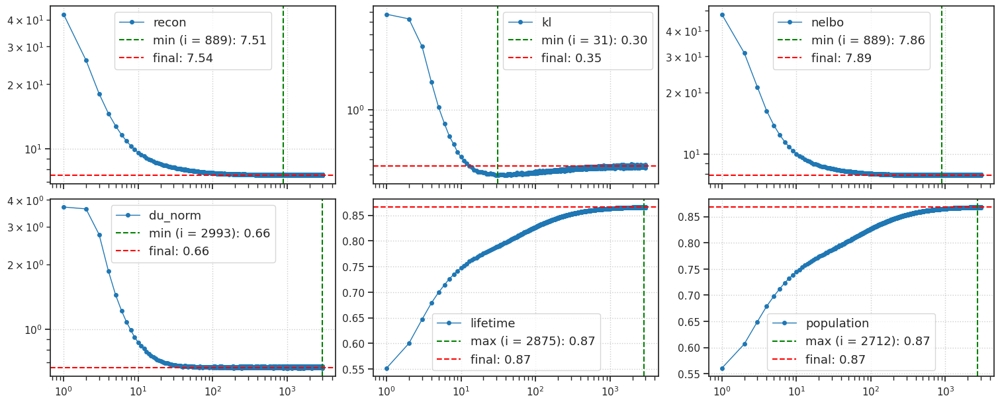

In [14]:
## Was: Jac only

______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

vld

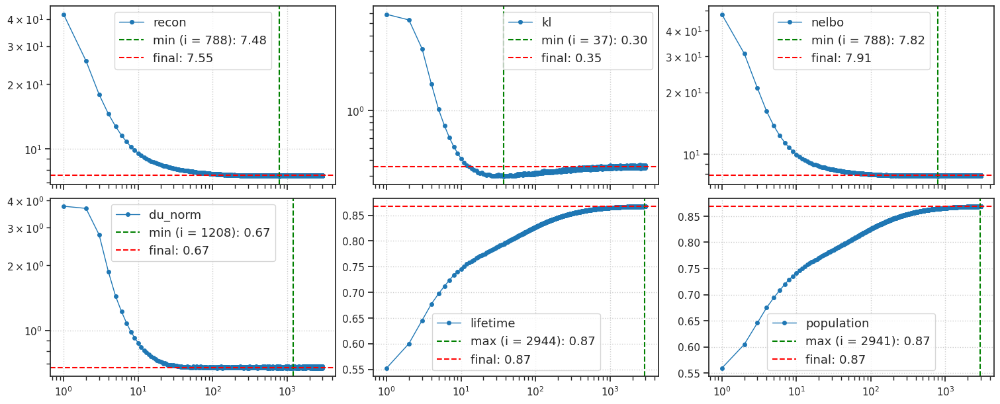

______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

vld

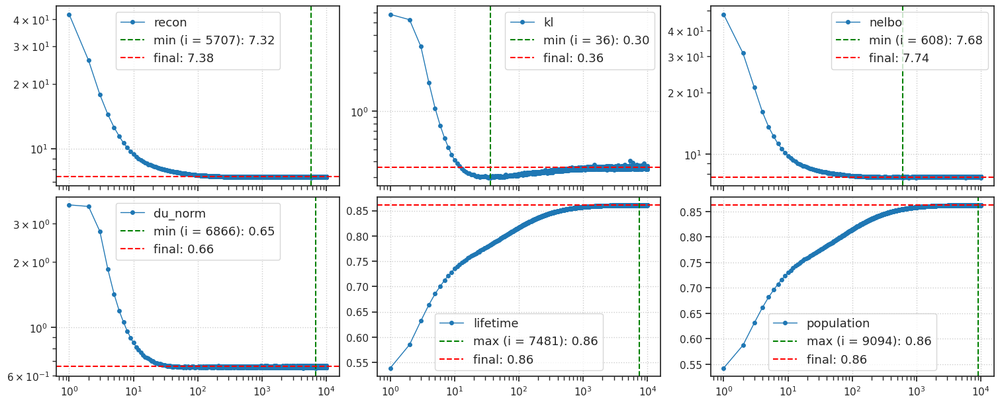

In [13]:
## Was: enc = jacob

In [22]:
%%time

kws = dict(
    seq_total=30000,
    seq_batch_sz=1000,
    n_data_batches=1,
    # active=~dead,
    full_data=True,
    return_recon=True,
)
results_to_plot = {
    name: tr.analysis(dl_name=name, **kws)
    for name in ['trn', 'vld'] # , 'tst']
}

100%|██████████████████████████████████| 1/1 [02:00<00:00, 120.24s/it]


CPU times: user 3min 36s, sys: 3min 23s, total: 6min 59s
Wall time: 6min 55s


______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

trn

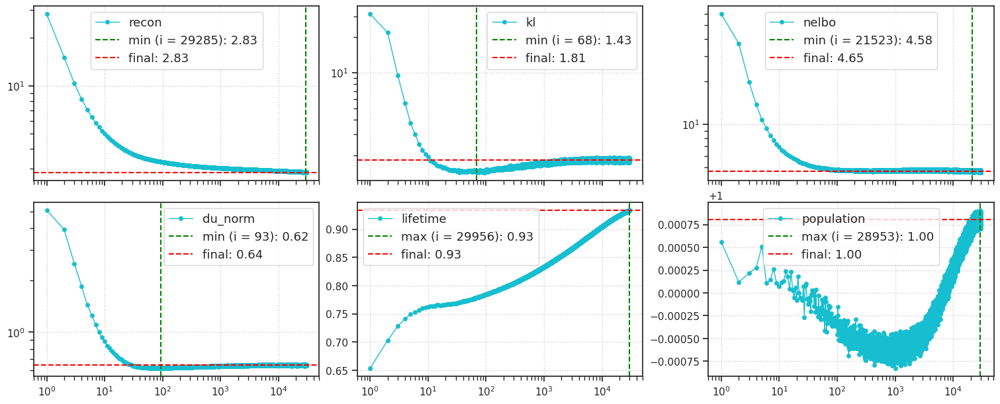

______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

vld

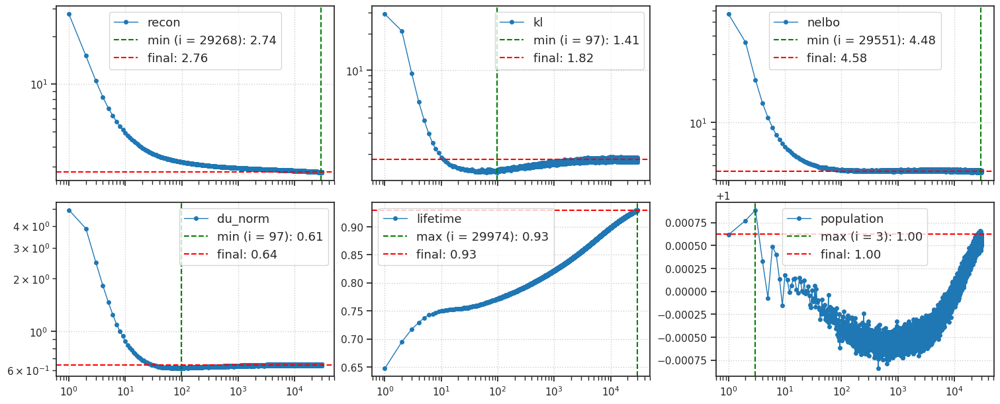

In [27]:
colors = {'trn': 'C9', 'vld': 'C0', 'tst': 'k'}
for name, d in results_to_plot.items():
    print('_' * 110)
    print('-' * 110)
    print(name)

    plot_convergence(d, color=colors[name])

______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

trn

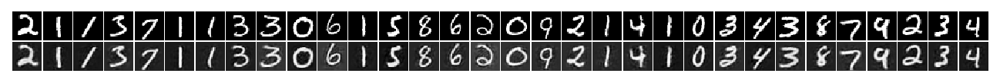

______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

vld

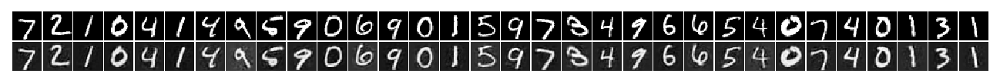

In [28]:
num = 32

for name, d in results_to_plot.items():
    print('_' * 110)
    print('-' * 110)
    print(name)
    
    x2p = np.concatenate([
        d['x'][:num, 0],
        d['y'][:num, -1].reshape(-1, *tr.model.cfg.input_sz[1:]),
    ])
    _ = plot_weights(x2p, nrows=2)

### generate

In [ ]:
n_samples = 64
tr.model.reset_state(n_samples)
tr.model.update_pred(temp=0.0)
pred = tr.model.pred

output = tr.model.generate(pred, seq=range(300))
output = output.stack()

loss_kl = tonp(torch.sum(output['loss_kl'], -1))
u = tr.model.log_rate.expand(n_samples, -1)
desc_len = tr.model.layer.loss_kl(u=u)
desc_len = tonp(torch.sum(desc_len, dim=-1))

list(output)

In [17]:
shape = (tr.model.cfg.input_sz, tr.model.cfg.input_sz)

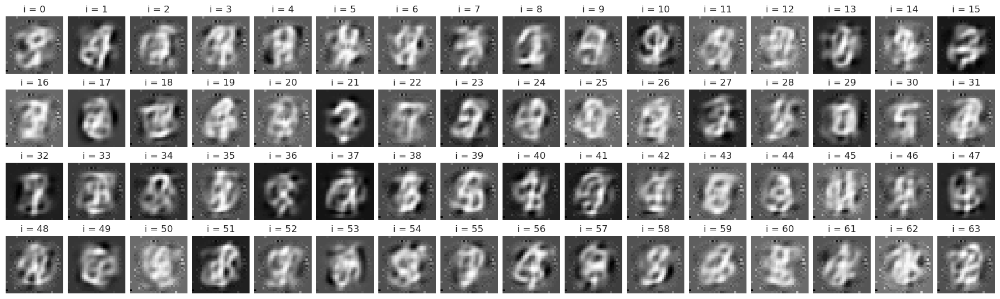

In [18]:
nrows = 4
ncols = int(np.ceil(len(pred) / nrows))
fig, axes = create_figure(nrows, ncols, (1.1 * ncols, 1.3 * nrows), 'all', 'all')
for sample_i, ax in enumerate(axes.flat):
    i, j = sample_i // ncols, sample_i % ncols
    x2p = tonp(pred[sample_i].reshape(shape))
    ax.imshow(x2p, cmap='Greys_r')
    ax.set_title(f"i = {sample_i}")
trim_axs(axes, len(pred))
remove_ticks(axes)
plt.show()

In [19]:
sample_i = 29

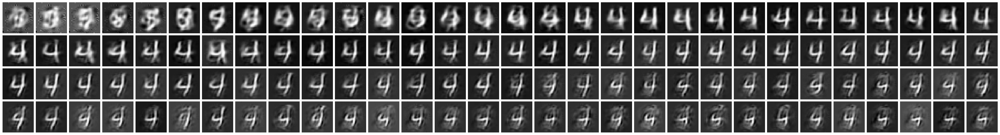

In [20]:
nrows, ncols = 4, 30
fig, axes = create_figure(nrows, ncols, (1.3 * ncols, 1.3 * nrows), 'all', 'all')
for idx, ax in enumerate(axes.flat):
    i, j = idx // ncols, idx % ncols
    x2p = tonp(output['recon'][sample_i, idx].reshape(shape))
    ax.imshow(x2p, cmap='Greys_r')
remove_ticks(axes)

In [21]:
order = np.argsort(desc_len)

In [ ]:
for i in range(len(pred)):
    sample_i = order[i]
    nrows, ncols = 4, 30
    fig, axes = create_figure(nrows, ncols, (1.3 * ncols, 1.3 * nrows), 'all', 'all')
    tit = ' ——— '.join([
        f"i = {i}, sample # {sample_i}",
        f"desc len = {desc_len[sample_i]:0.2g}",
    ])
    fig.suptitle(tit, fontsize=25, y=1.14)
    
    x2p = tonp(pred[sample_i].reshape(shape))
    axes[0, 0].imshow(x2p, cmap='Greys_r')
    
    for idx, ax in enumerate(axes.flat[1:], start=1):
        i, j = idx // ncols, idx % ncols
        x2p = tonp(output['recon'][sample_i, idx - 1].reshape(28, 28))
        ax.imshow(x2p, cmap='Greys_r')
    remove_ticks(axes)
    plt.show()

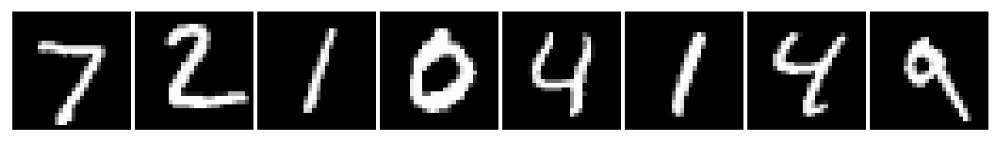

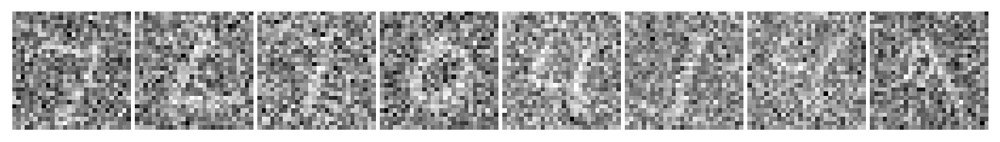

In [71]:
x = next(iter(tr.dl_vld))[0][:8]
x_noisy = x + torch.randn_like(x) * 0.7

_ = plot_weights(tonp(x.squeeze()), nrows=1)
_ = plot_weights(tonp(x_noisy.squeeze()), nrows=1)

In [72]:
tr.model.reset_state(len(x))
tr.model.reset_pred()

output = tr.model(x_noisy, seq=range(300))
output = output.stack()

In [78]:
sample_i = 1

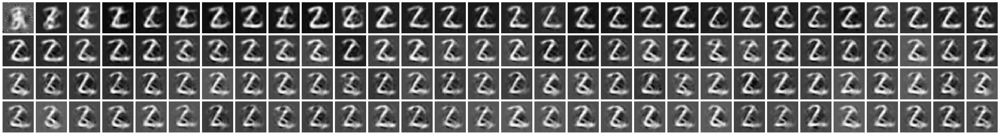

In [79]:
nrows, ncols = 4, 30
fig, axes = create_figure(nrows, ncols, (1.3 * ncols, 1.3 * nrows), 'all', 'all')
for idx, ax in enumerate(axes.flat):
    i, j = idx // ncols, idx % ncols
    x2p = tonp(output['recon'][sample_i, idx].reshape(shape))
    ax.imshow(x2p, cmap='Greys_r')
remove_ticks(axes)

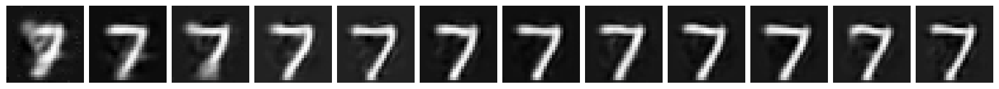

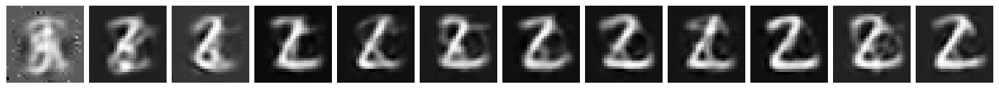

In [80]:
nrows, ncols = 1, 12
fig, axes = create_figure(nrows, ncols, (1.3 * ncols, 1.3 * nrows), 'all', 'all')
for idx, ax in enumerate(axes.flat):
    i, j = idx // ncols, idx % ncols
    x2p = tonp(output['recon'][sample_i, idx].reshape(shape))
    ax.imshow(x2p, cmap='Greys_r')
remove_ticks(axes)

## MNIST — Gaussian

### Get configs

In [3]:
model_type = 'gaussian'
cfg_vae, cfg_tr = default_configs('MNIST', model_type, 'jacob|mlp+b')

cfg_vae['track_stats'] = True
cfg_vae['n_latents'] = [128]
cfg_vae['init_scale'] = 1e-2
cfg_vae['seq_len'] = 8

cfg_tr['lr'] = 2e-3
cfg_tr['epochs'] = 1500
cfg_tr['batch_size'] = 600
cfg_tr['kl_beta'] = 1.0

### Make model + trainer

In [4]:
vae = MODEL_CLASSES[model_type](CFG_CLASSES[model_type](**cfg_vae))
tr = TrainerVAE(vae, ConfigTrainVAE(**cfg_tr), device=device)

tr.n_iters

150000

### Print info

+-------------+------------+
| Module Name | Num Params |
+-------------+------------+
|    IGVAE    |  467.5 K   |
|     ———     |    ———     |
|    layer    |  467.5 K   |
+-------------+------------+

gaussian_MNIST_t-8_z-[128]_k-32_<jacob|mlp+b>
b600-ep1500-lr(0.002)_beta(1:0x0.3)_gr(100)_(2024_09_11,09:15)

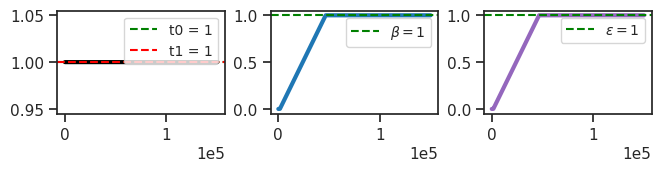

In [5]:
vae.print()
print(f"{vae.cfg.name()}\n{tr.cfg.name()}_({vae.timestamp})\n")
tr.show_schedules()

In [6]:
print_num_params(tr.model.layer)

+---------------+------------+
|  Module Name  | Num Params |
+---------------+------------+
| GaussianLayer |  467.5 K   |
|      ———      |    ———     |
|      dec      |  467.1 K   |
+---------------+------------+

In [7]:
print(tr.model.layer.dec)

Sequential(
  (0): Linear(in_features=128, out_features=234, bias=True)
  (1): SiLU(inplace=True)
  (2): Linear(in_features=234, out_features=428, bias=True)
  (3): SiLU(inplace=True)
  (4): Linear(in_features=428, out_features=784, bias=True)
)

In [8]:
print(f"{vars(tr.model.cfg)}\n\n\n{vars(tr.cfg)}")

{'latent_act': None, 'type': 'gaussian', 'n_ch': 32, 'seq_len': 8, 'n_latents': [128], 'lateral_ker_sz': [None], 
'jac_type': 'grad', 'enc_type': 'jacob', 'dec_type': 'mlp', 'enc_bias': False, 'dec_bias': True, 'enc_norm': False,
'dec_norm': False, 'dataset': 'MNIST', 'input_sz': (1, 28, 28), 'res_eps': 1.0, 'clamp_u': 5.0, 'clamp_du': 5.0, 
'init_dist': 't', 'init_scale': 0.01, 'activation_fn': 'swish', 'fit_prior': True, 'use_bn': False, 'use_se': True,
'track_stats': True, 'seed': 0, 'base_dir': '/home/hadi/Projects/PoissonVAE', 'data_dir': '/home/hadi/Datasets', 
'runs_dir': '/home/hadi/Projects/PoissonVAE/runs/gaussian_MNIST_t-8_z-[128]_k-32_<jacob|mlp+b>', 'mods_dir': 
'/home/hadi/Projects/PoissonVAE/models/gaussian_MNIST_t-8_z-[128]_k-32_<jacob|mlp+b>', 'results_dir': 
'/home/hadi/Projects/PoissonVAE/results'}


{'lr': 0.002, 'epochs': 1500, 'batch_size': 600, 'file_name': None, 'warm_restart': 1, 'warmup_epochs': 5, 
'optimizer': 'adamax_fast', 'optimizer_kws': {'weight_decay': 0.0003, 'betas': (0.9, 0.999), 'eps': 1e-08}, 
'scheduler_type': 'cosine', 'scheduler_kws': {'T_max': 498.3333333333333, 'eta_min': 1e-05}, 'ema_rate': None, 
'grad_clip': 100, 'chkpt_freq': 50, 'eval_freq': 20, 'log_freq': 10, 'use_amp': False, 'method': 'mc', 'kl_beta': 
1.0, 'kl_beta_min': 0.0001, 'kl_balancer': None, 'kl_time_adjuster': None, 'kl_anneal_cycles': 0, 
'kl_anneal_portion': 0.3, 'kl_const_portion': 0.01, 'lambda_anneal': False, 'lambda_init': 0.0, 'lambda_norm': 0.0,
'temp_anneal_portion': 0.0, 'temp_anneal_type': 'lin', 'temp_start': 1.0, 'temp_stop': 1.0}

### Fit model

In [9]:
tr.train(f"warm1_clamp-u:({tr.model.cfg.clamp_u})-du:({tr.model.cfg.clamp_du})_{tr.cfg.name()}")

epoch # 1500, avg loss: 20.589341: 100%|██| 1500/1500 [1:10:00<00:00,  2.80s/it]


100%|███████████████████████████████████████████| 17/17 [00:00<00:00, 73.15it/s]


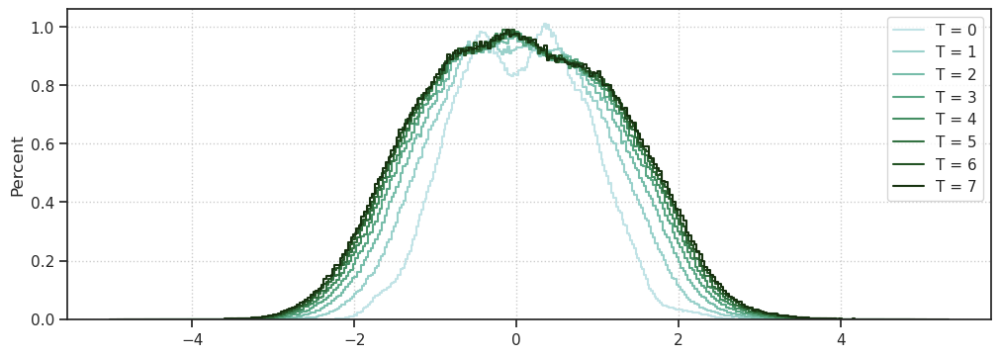

In [14]:
posterior_mus = collections.defaultdict(list)
for x, *_ in tqdm(iter(tr.dl_vld)):
    output = tr.model.xtract_ftr(x)
    for t, gaus in output['dist'].items():
        posterior_mus[t].append(gaus.loc)
posterior_mus = {
    t: tonp(torch.cat(v)) for t, v
    in posterior_mus.items()
}


fig, ax = create_figure(1, 1, (10, 3.5))
pal = get_cubehelix_palette(tr.model.cfg.seq_len, start=1.7)

for i, (t, v) in enumerate(posterior_mus.items()):
    sns.histplot(
        v.ravel(),
        stat='percent',
        element='step',
        fill=False,
        color=pal[i],
        label=f"T = {t}",
        ax=ax,
    )
ax.legend()
ax.grid()
plt.show()

In [15]:
pal

[[0.7557632593143155, 0.8902249850399027, 0.9001691189479273],
 [0.6057217751623265, 0.8196641304054504, 0.7965697991797994],
 [0.4680797229158485, 0.7411567386281301, 0.6661255838520083],
 [0.3536781536375616, 0.6531311833771306, 0.523350354549206],
 [0.2662487673701268, 0.5570948674579747, 0.3856322871470521],
 [0.19574481261488885, 0.44478866026832764, 0.25336936489929573],
 [0.1414944864322668, 0.3261888253769538, 0.14618596117560884],
 [0.08998512557869877, 0.19509468023303345, 0.06289173619512423]]

In [3]:
# model_name = 'poisson_uniform_c(-2)_MNIST_t-10_z-[128]_k-32_<jacob|mlp+b>'
# fit_name = 'nexp-per-time-1e-6_b200-ep500-lr(0.002)_beta(5:0x0.5)_temp(0.05:lin-0.5)_gr(1000)_(2024_09_09,20:44)'
# tr, meta = load_model(model_name, fit_name, device=device)
# meta['checkpoint']

500

### Task:

Does lowering the beta hurt gold standard? **yes**

**Finding:** For poisson, strong beta = 10 worked for T = 10 (as opposed to gaussian which was terrible)

Now: reprouce gold standard with this:
```Python
clamp = 4.0 + self.eps * (10.0 - 4.0)
```

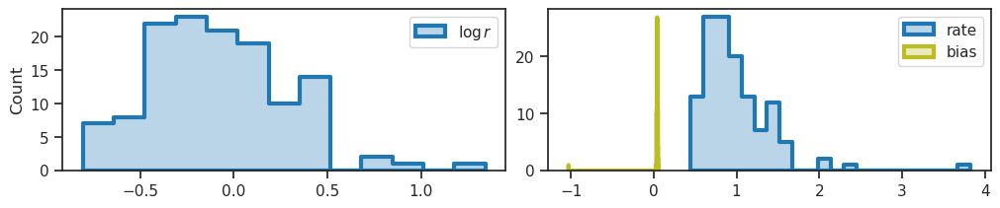

In [13]:
log_rate = tonp(tr.model.layer.log_rate).ravel()
bias = tonp(tr.model.layer.bias).ravel()

fig, axes = create_figure(1, 2, (10, 2))
kws = dict(fill=True, lw=3, alpha=0.3, ax=axes[0])
sns.histplot(log_rate, color='C0', element='step', label=r'$\log r$', **kws)

kws = dict(fill=True, lw=3, alpha=0.3, ax=axes[1])
sns.histplot(np.exp(log_rate), color='C0', element='step', label='rate', **kws)
sns.histplot(bias, color='C8', element='step', label='bias', **kws)

axes[1].set(ylabel='')
add_legend(axes)

plt.show()

In [14]:
dead = log_rate < -1
dead.sum(), (~dead).sum(), dead.sum() / len(dead)

(0, 128, 0.0)

In [18]:
%%time

kws = dict(
    seq_total=10000,
    seq_batch_sz=1000,
    n_data_batches=None,
    # active=~dead,
    # full_data=True,
    # return_recon=True,
)
results = {
    name: tr.analysis(dl_name=name, **kws)
    for name in  ['vld'] # 'trn'] # , 'tst']
}

100%|█████████████████████████████████| 17/17 [03:53<00:00, 13.76s/it]


CPU times: user 3min 49s, sys: 16.2 s, total: 4min 6s
Wall time: 4min 5s


______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

vld

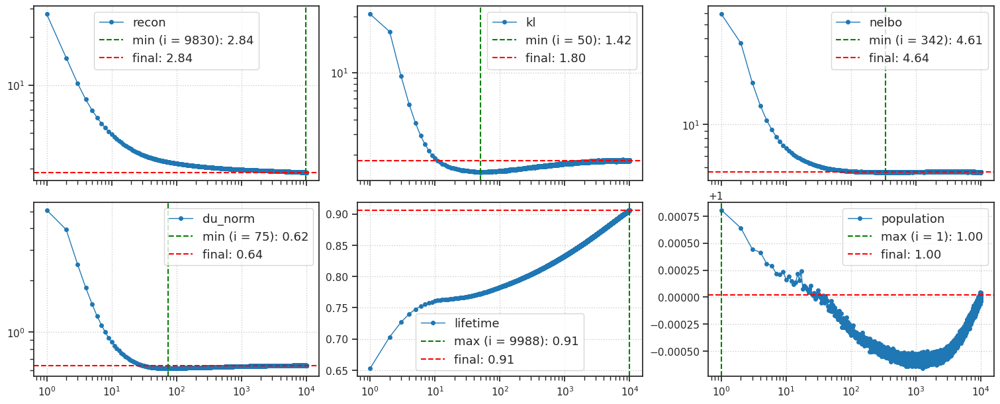

In [26]:
colors = {'trn': 'C9', 'vld': 'C0', 'tst': 'k'}
for name, d in results.items():
    print('_' * 110)
    print('-' * 110)
    print(name)

    plot_convergence(d, color=colors[name])

______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

vld

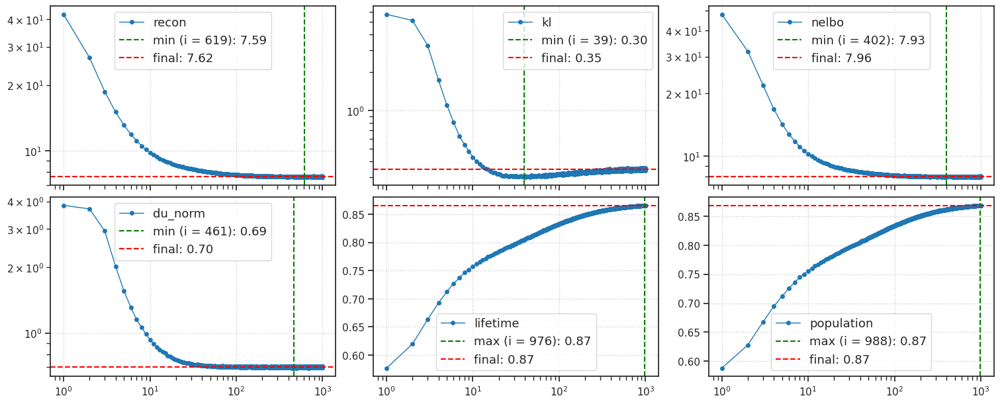

______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

vld

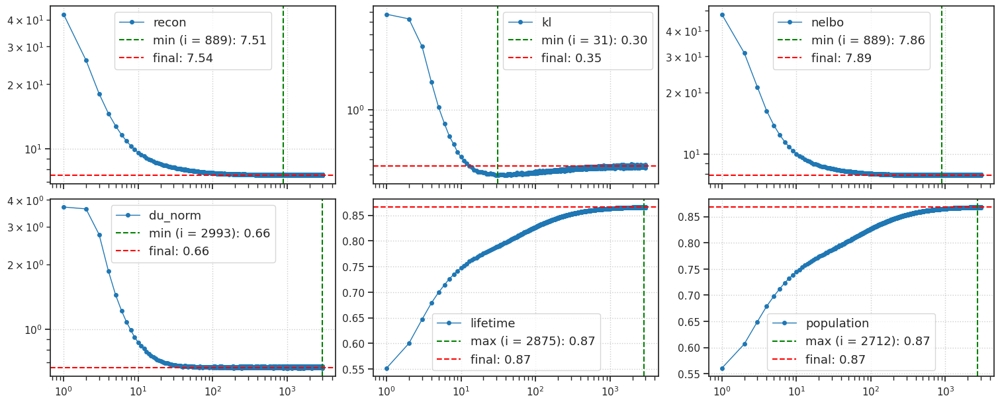

In [14]:
## Was: Jac only

______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

vld

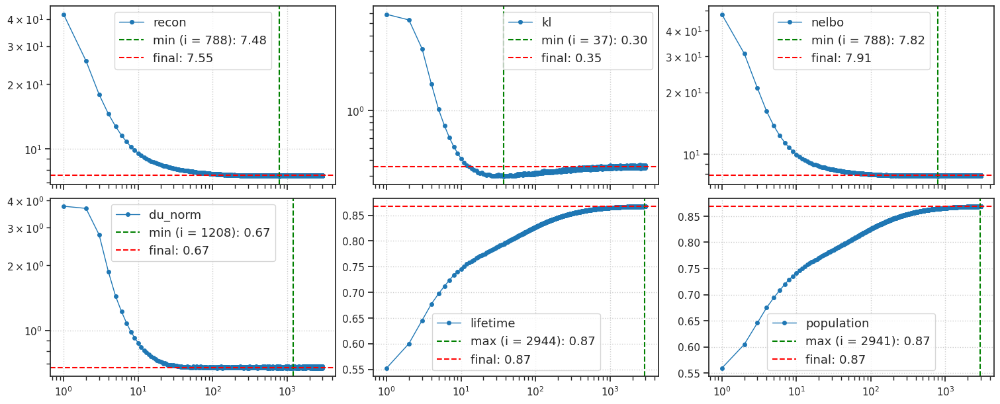

______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

vld

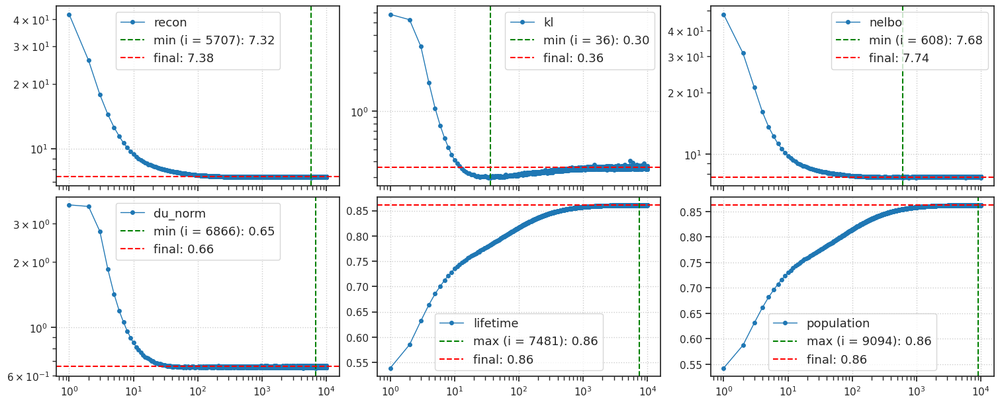

In [13]:
## Was: enc = jacob

In [22]:
%%time

kws = dict(
    seq_total=30000,
    seq_batch_sz=1000,
    n_data_batches=1,
    # active=~dead,
    full_data=True,
    return_recon=True,
)
results_to_plot = {
    name: tr.analysis(dl_name=name, **kws)
    for name in ['trn', 'vld'] # , 'tst']
}

100%|██████████████████████████████████| 1/1 [02:00<00:00, 120.24s/it]


CPU times: user 3min 36s, sys: 3min 23s, total: 6min 59s
Wall time: 6min 55s


______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

trn

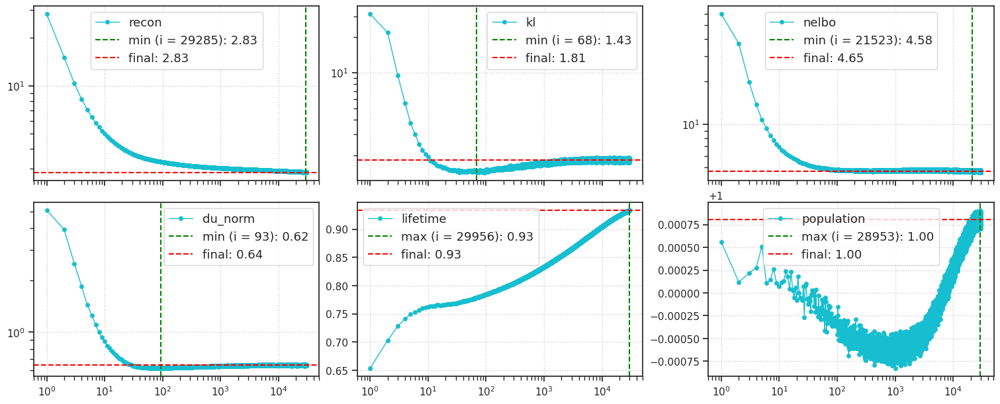

______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

vld

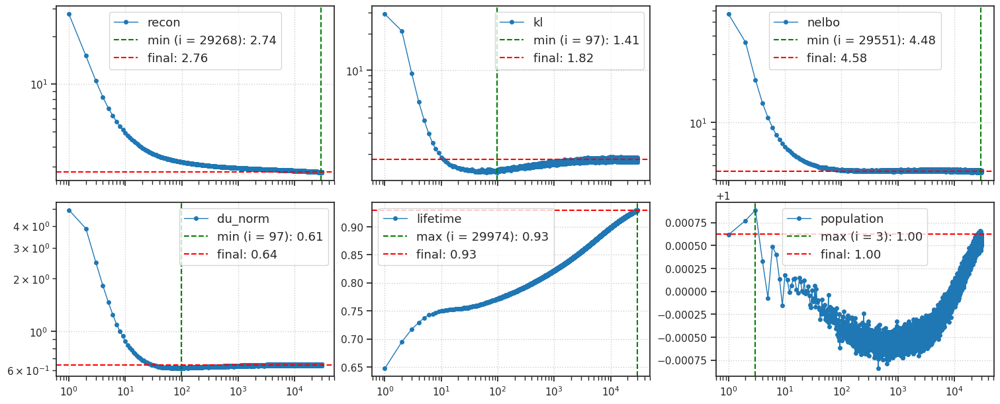

In [27]:
colors = {'trn': 'C9', 'vld': 'C0', 'tst': 'k'}
for name, d in results_to_plot.items():
    print('_' * 110)
    print('-' * 110)
    print(name)

    plot_convergence(d, color=colors[name])

______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

trn

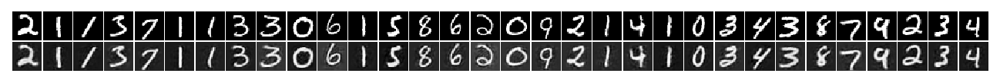

______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

vld

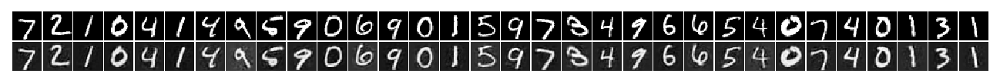

In [28]:
num = 32

for name, d in results_to_plot.items():
    print('_' * 110)
    print('-' * 110)
    print(name)
    
    x2p = np.concatenate([
        d['x'][:num, 0],
        d['y'][:num, -1].reshape(-1, *tr.model.cfg.input_sz[1:]),
    ])
    _ = plot_weights(x2p, nrows=2)

### generate

In [29]:
n_samples = 64
tr.model.reset_state(n_samples)
tr.model.update_pred(temp=0.0)
pred = tr.model.pred

output = tr.model.generate(pred, seq=range(300))
output = output.stack()

loss_kl = tonp(torch.sum(output['loss_kl'], -1))
u = tr.model.log_rate.expand(n_samples, -1)
desc_len = tr.model.layer.loss_kl(u=u)
desc_len = tonp(torch.sum(desc_len, dim=-1))

list(output)

RuntimeError: one of the variables needed for gradient computation has been modified by an inplace operation: [torch.cuda.FloatTensor [64, 128]], which is output 0 of ExpBackward0, is at version 1; expected version 0 instead. Hint: enable anomaly detection to find the operation that failed to compute its gradient, with torch.autograd.set_detect_anomaly(True).

In [17]:
shape = (tr.model.cfg.input_sz, tr.model.cfg.input_sz)

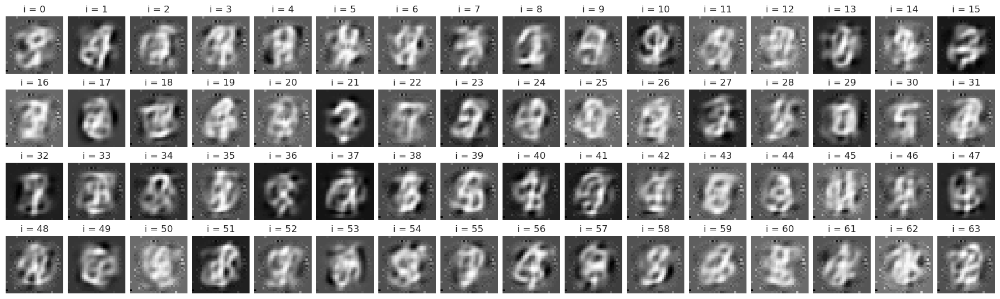

In [18]:
nrows = 4
ncols = int(np.ceil(len(pred) / nrows))
fig, axes = create_figure(nrows, ncols, (1.1 * ncols, 1.3 * nrows), 'all', 'all')
for sample_i, ax in enumerate(axes.flat):
    i, j = sample_i // ncols, sample_i % ncols
    x2p = tonp(pred[sample_i].reshape(shape))
    ax.imshow(x2p, cmap='Greys_r')
    ax.set_title(f"i = {sample_i}")
trim_axs(axes, len(pred))
remove_ticks(axes)
plt.show()

In [19]:
sample_i = 29

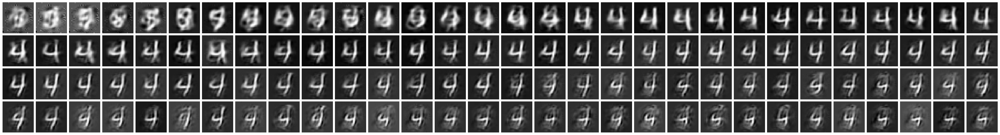

In [20]:
nrows, ncols = 4, 30
fig, axes = create_figure(nrows, ncols, (1.3 * ncols, 1.3 * nrows), 'all', 'all')
for idx, ax in enumerate(axes.flat):
    i, j = idx // ncols, idx % ncols
    x2p = tonp(output['recon'][sample_i, idx].reshape(shape))
    ax.imshow(x2p, cmap='Greys_r')
remove_ticks(axes)

In [21]:
order = np.argsort(desc_len)

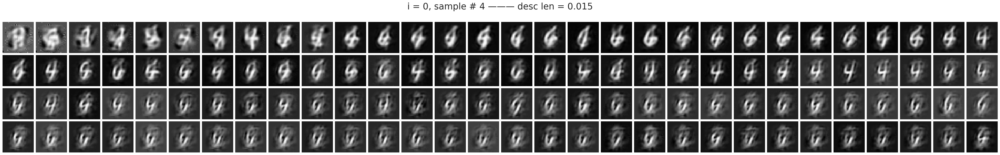

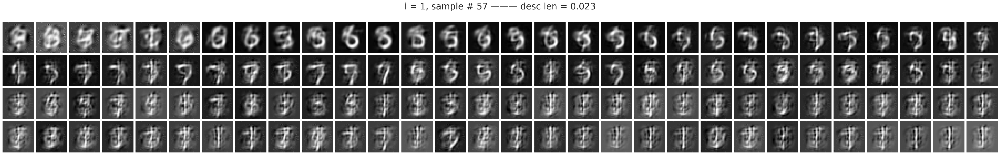

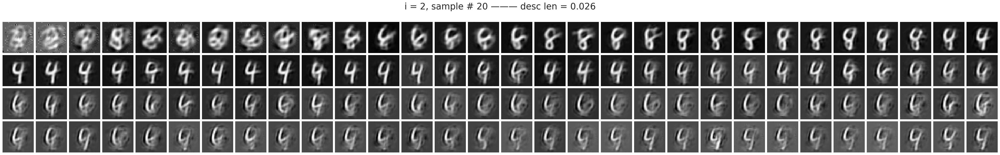

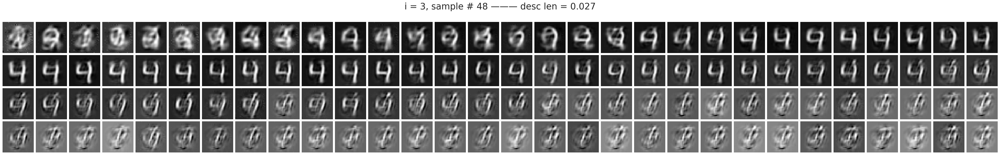

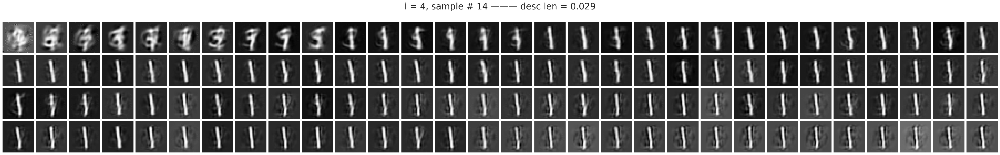

...

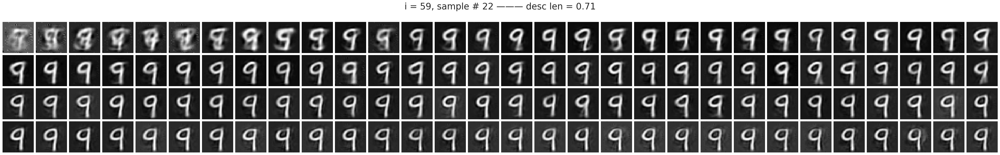

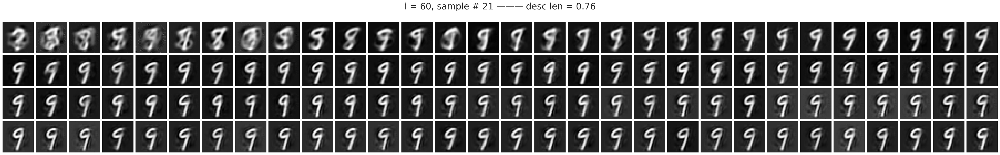

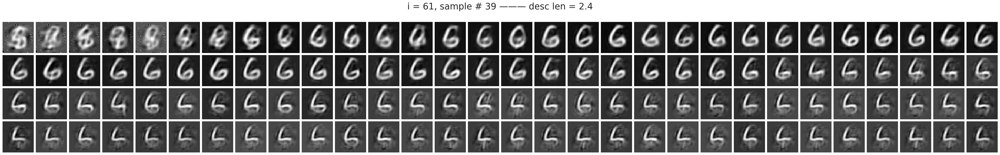

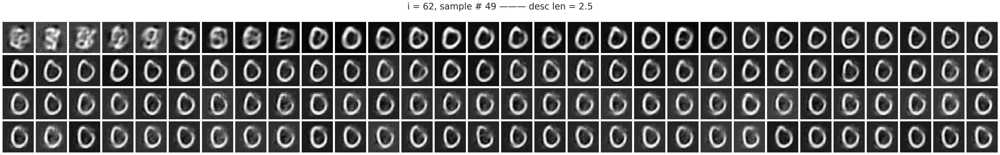

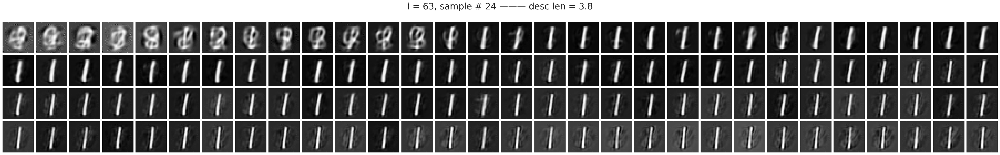

In [22]:
for i in range(len(pred)):
    sample_i = order[i]
    nrows, ncols = 4, 30
    fig, axes = create_figure(nrows, ncols, (1.3 * ncols, 1.3 * nrows), 'all', 'all')
    tit = ' ——— '.join([
        f"i = {i}, sample # {sample_i}",
        f"desc len = {desc_len[sample_i]:0.2g}",
    ])
    fig.suptitle(tit, fontsize=25, y=1.14)
    
    x2p = tonp(pred[sample_i].reshape(shape))
    axes[0, 0].imshow(x2p, cmap='Greys_r')
    
    for idx, ax in enumerate(axes.flat[1:], start=1):
        i, j = idx // ncols, idx % ncols
        x2p = tonp(output['recon'][sample_i, idx - 1].reshape(28, 28))
        ax.imshow(x2p, cmap='Greys_r')
    remove_ticks(axes)
    plt.show()

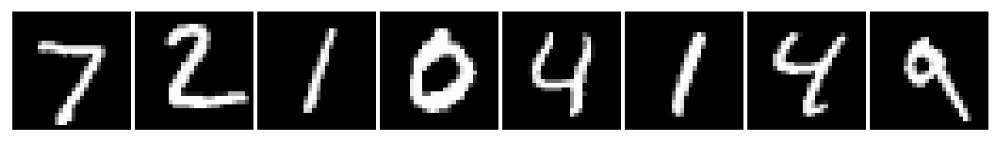

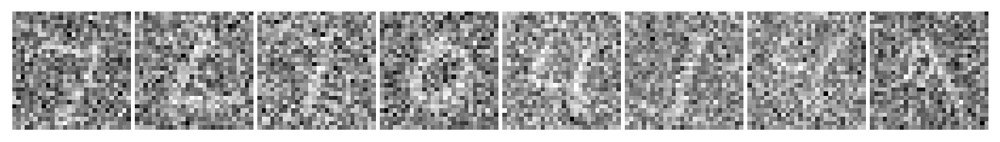

In [71]:
x = next(iter(tr.dl_vld))[0][:8]
x_noisy = x + torch.randn_like(x) * 0.7

_ = plot_weights(tonp(x.squeeze()), nrows=1)
_ = plot_weights(tonp(x_noisy.squeeze()), nrows=1)

In [72]:
tr.model.reset_state(len(x))
tr.model.reset_pred()

output = tr.model(x_noisy, seq=range(300))
output = output.stack()

In [78]:
sample_i = 1

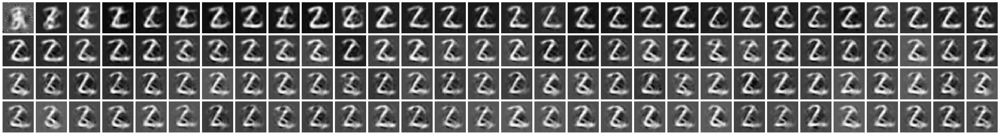

In [79]:
nrows, ncols = 4, 30
fig, axes = create_figure(nrows, ncols, (1.3 * ncols, 1.3 * nrows), 'all', 'all')
for idx, ax in enumerate(axes.flat):
    i, j = idx // ncols, idx % ncols
    x2p = tonp(output['recon'][sample_i, idx].reshape(shape))
    ax.imshow(x2p, cmap='Greys_r')
remove_ticks(axes)

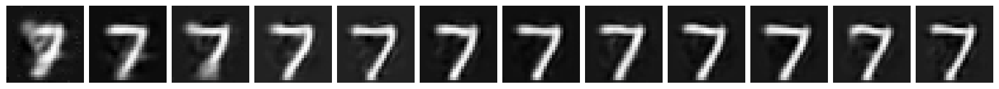

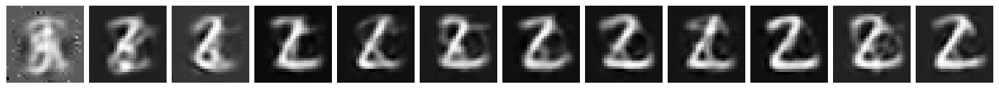

In [80]:
nrows, ncols = 1, 12
fig, axes = create_figure(nrows, ncols, (1.3 * ncols, 1.3 * nrows), 'all', 'all')
for idx, ax in enumerate(axes.flat):
    i, j = idx // ncols, idx % ncols
    x2p = tonp(output['recon'][sample_i, idx].reshape(shape))
    ax.imshow(x2p, cmap='Greys_r')
remove_ticks(axes)

## MNIST (hybrid)

### Get configs

In [3]:
model_type = 'poisson'
cfg_vae, cfg_tr = default_configs('MNIST', model_type, 'jacob|mlp+b')

cfg_vae['n_latents'] = [128]
cfg_vae['init_scale'] = 1e-2
cfg_vae['seq_len'] = 10

cfg_tr['lr'] = 2e-3
cfg_tr['epochs'] = 500
cfg_tr['batch_size'] = 200
cfg_tr['kl_beta'] = 5.0

cfg_tr['kl_time_adjuster'] = None

### Make model + trainer

In [4]:
vae = MODEL_CLASSES[model_type](CFG_CLASSES[model_type](**cfg_vae))

from vae.layers import _build_mlp

self = vae.layer
self.enc = _build_mlp(
    input_dim=self.input_dim,
    output_dim=self._enc_out_channel(),
    activation_fn=self._cfg.activation_fn,
    n_hidden=2,
)

tr = TrainerVAE(vae, ConfigTrainVAE(**cfg_tr), device=device)

In [5]:
tr.n_iters

150000

### Print info

+-------------+------------+
| Module Name | Num Params |
+-------------+------------+
|    IPVAE    |  933.2 K   |
|     ———     |    ———     |
|    layer    |  933.2 K   |
+-------------+------------+

poisson_uniform_c(-2)_MNIST_t-10_z-[128]_k-32_<jacob|mlp+b>
b200-ep500-lr(0.002)_beta(5:0x0.5)_temp(0.05:lin-0.5)_gr(1000)_(2024_09_08,17:35)

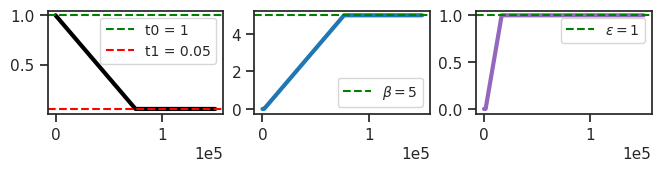

In [6]:
vae.print()
print(f"{vae.cfg.name()}\n{tr.cfg.name()}_({vae.timestamp})\n")
tr.show_schedules()

In [7]:
print_num_params(tr.model.layer)

+--------------+------------+
| Module Name  | Num Params |
+--------------+------------+
| PoissonLayer |  933.2 K   |
|     ———      |    ———     |
|     dec      |  467.1 K   |
|     enc      |  465.9 K   |
+--------------+------------+

In [8]:
# print(tr.model.layer.dec)

### Fit model

In [8]:
tr.train(f"hybrid:mlp+jacob_{tr.cfg.name()}")

epoch # 500, avg loss: 16.870731: 100%|█████| 500/500 [1:17:15<00:00,  9.27s/it]


In [5]:
# model_name = 'poisson_uniform_c(-2)_MNIST_t-10_z-[128]_k-32_<jacob|mlp+b>'
# fit_name = 'mc_b200-ep500-lr(0.002)_beta(5:0x0.5)_temp(0.05:lin-0.5)_gr(1000)_(2024_09_05,17:20)'
# tr, meta = load_model(model_name, fit_name, device=device)
# meta['checkpoint']

500

### Task:

Does lowering the beta hurt gold standard? **yes**

**Finding:** For poisson, strong beta = 10 worked for T = 10 (as opposed to gaussian which was terrible)

Now: reprouce gold standard with this:
```Python
clamp = 4.0 + self.eps * (10.0 - 4.0)
```

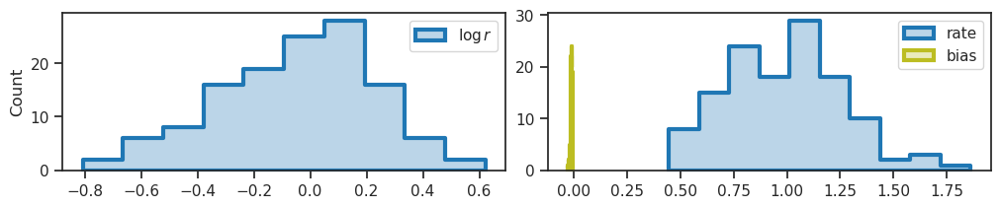

In [9]:
log_rate = tonp(tr.model.layer.log_rate).ravel()
bias = tonp(tr.model.layer.bias).ravel()

fig, axes = create_figure(1, 2, (10, 2))
kws = dict(fill=True, lw=3, alpha=0.3, ax=axes[0])
sns.histplot(log_rate, color='C0', element='step', label=r'$\log r$', **kws)

kws = dict(fill=True, lw=3, alpha=0.3, ax=axes[1])
sns.histplot(np.exp(log_rate), color='C0', element='step', label='rate', **kws)
sns.histplot(bias, color='C8', element='step', label='bias', **kws)

axes[1].set(ylabel='')
add_legend(axes)

plt.show()

In [10]:
dead = log_rate < -2.0
dead.sum(), (~dead).sum(), dead.sum() / len(dead)

(0, 128, 0.0)

In [15]:
%%time

kws = dict(
    seq_total=5000,
    seq_batch_sz=1000,
    n_data_batches=None,
    active=~dead,
    # full_data=True,
    # return_recon=True,
)
results = {
    name: tr.analysis(dl_name=name, **kws)
    for name in  ['vld'] # 'trn'] # , 'tst']
}

100%|█████████████████████████████████| 50/50 [05:02<00:00,  6.05s/it]


CPU times: user 4min 59s, sys: 9.51 s, total: 5min 9s
Wall time: 5min 8s


______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

vld

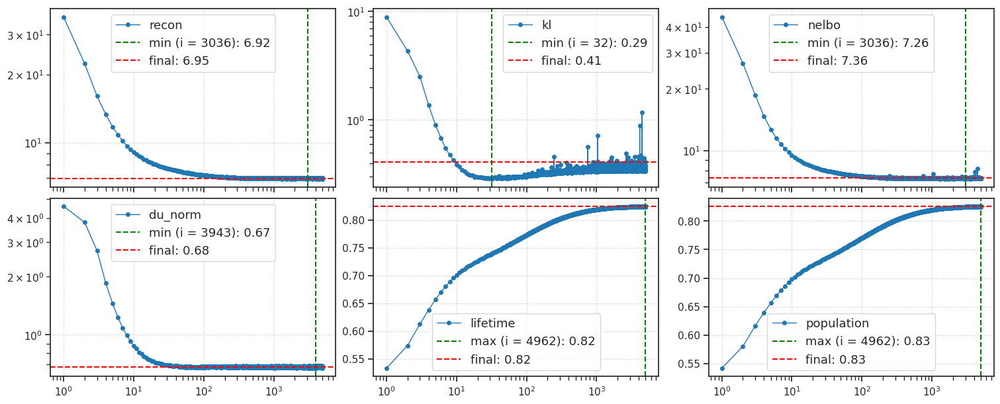

In [16]:
colors = {'trn': 'C9', 'vld': 'C0', 'tst': 'k'}
for name, d in results.items():
    if name != 'trn':
        print('\n\n\n')
    print('_' * 110)
    print('-' * 110)
    print(name)

    plot_convergence(d, color=colors[name])

______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

vld

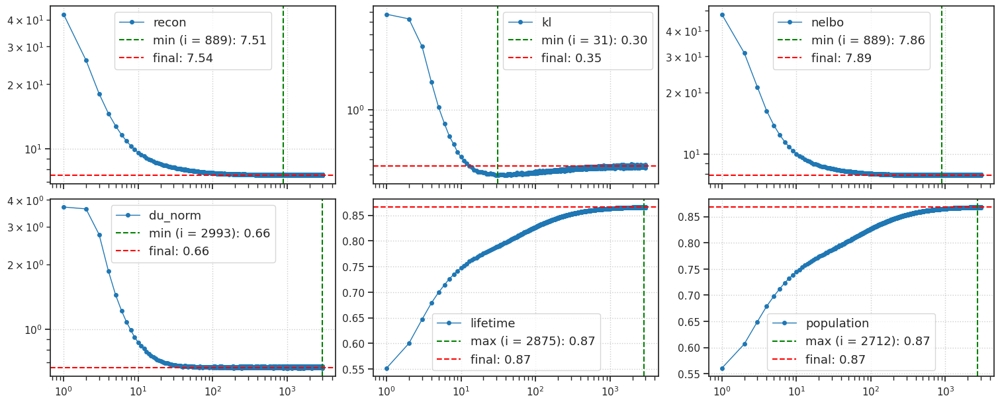

In [14]:
## Was: Jac only

______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

vld

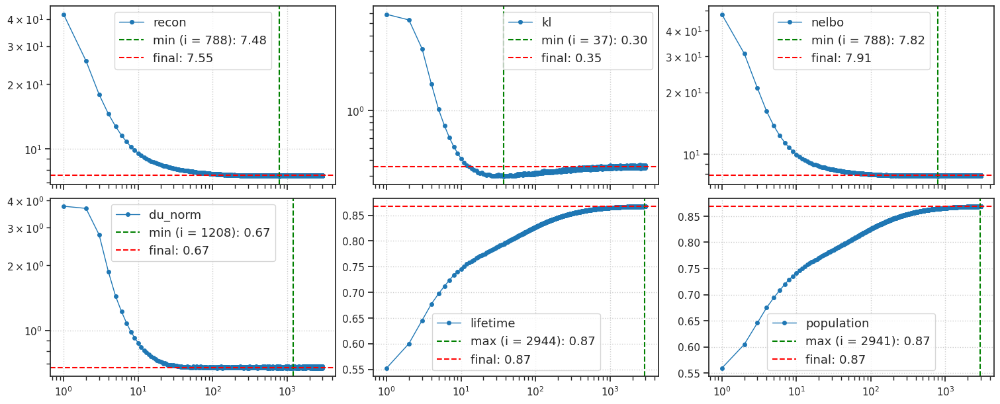

______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

vld

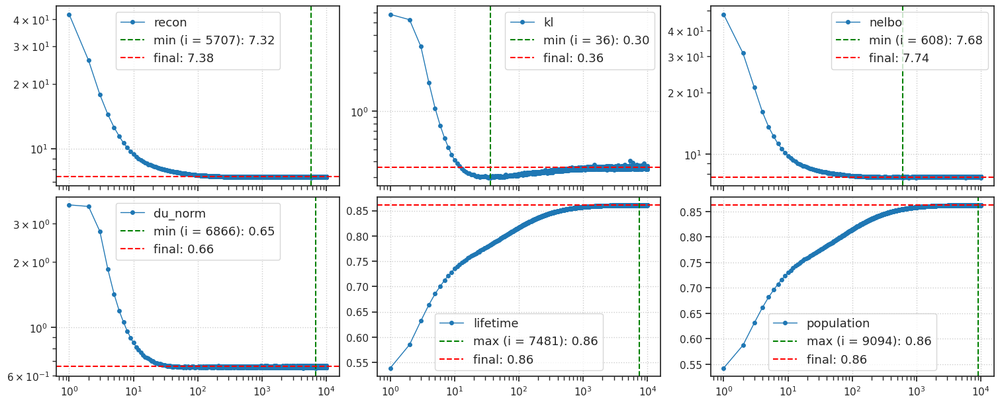

In [13]:
## Was: enc = jacob

In [14]:
%%time

kws = dict(
    seq_total=3000,
    seq_batch_sz=1000,
    n_data_batches=1,
    active=~dead,
    full_data=True,
    return_recon=True,
)
results_to_plot = {
    name: tr.analysis(dl_name=name, **kws)
    for name in ['trn', 'vld'] # , 'tst']
}

100%|███████████████████████████████████| 1/1 [00:08<00:00,  8.01s/it]


CPU times: user 22.4 s, sys: 2.59 s, total: 24.9 s
Wall time: 18.8 s


______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

trn

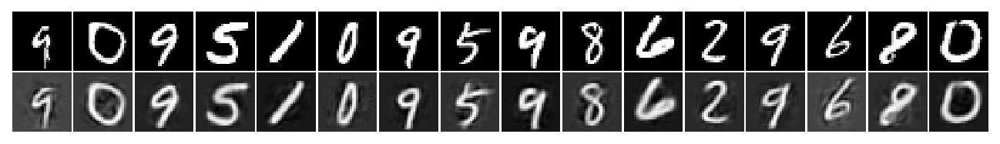

______________________________________________________________________________________________________________

--------------------------------------------------------------------------------------------------------------

vld

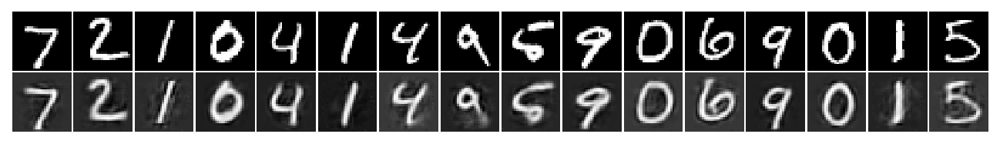

In [15]:
num = 16
shape = (tr.model.cfg.input_sz, ) * 2

for name, d in results_to_plot.items():
    if name != 'trn':
        print('\n\n\n')
    print('_' * 110)
    print('-' * 110)
    print(name)
    
    x2p = np.concatenate([
        d['x'][:num, 0],
        d['y'][:num, -1].reshape(-1, *shape),
    ])
    _ = plot_weights(x2p, nrows=2)

### generate

In [16]:
n_samples = 64
tr.model.reset_state(n_samples)
tr.model.update_pred(temp=0.0)
pred = tr.model.pred

output = tr.model.generate(pred, seq=range(300))
output = output.stack()

loss_kl = tonp(torch.sum(output['loss_kl'], -1))
u = tr.model.log_rate.expand(n_samples, -1)
desc_len = tr.model.layer.loss_kl(u=u)
desc_len = tonp(torch.sum(desc_len, dim=-1))

list(output)

['ff', 'dist', 'spks', 'recon', 'loss_kl', 'loss_recon']

In [17]:
shape = (tr.model.cfg.input_sz, tr.model.cfg.input_sz)

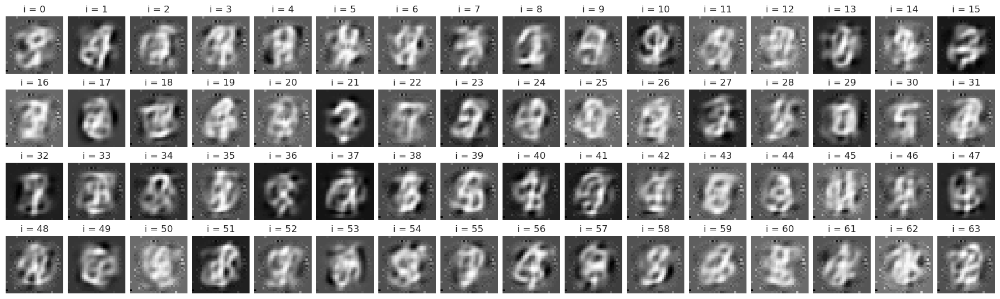

In [18]:
nrows = 4
ncols = int(np.ceil(len(pred) / nrows))
fig, axes = create_figure(nrows, ncols, (1.1 * ncols, 1.3 * nrows), 'all', 'all')
for sample_i, ax in enumerate(axes.flat):
    i, j = sample_i // ncols, sample_i % ncols
    x2p = tonp(pred[sample_i].reshape(shape))
    ax.imshow(x2p, cmap='Greys_r')
    ax.set_title(f"i = {sample_i}")
trim_axs(axes, len(pred))
remove_ticks(axes)
plt.show()

In [19]:
sample_i = 29

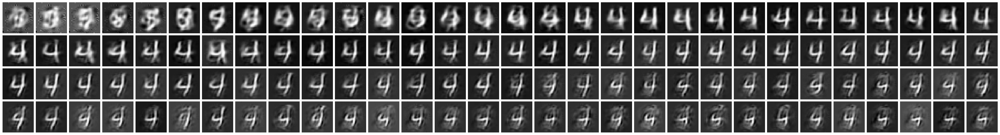

In [20]:
nrows, ncols = 4, 30
fig, axes = create_figure(nrows, ncols, (1.3 * ncols, 1.3 * nrows), 'all', 'all')
for idx, ax in enumerate(axes.flat):
    i, j = idx // ncols, idx % ncols
    x2p = tonp(output['recon'][sample_i, idx].reshape(shape))
    ax.imshow(x2p, cmap='Greys_r')
remove_ticks(axes)

In [21]:
order = np.argsort(desc_len)

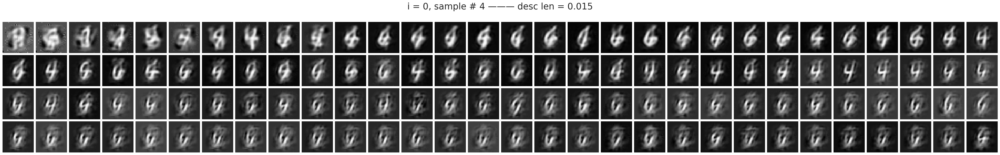

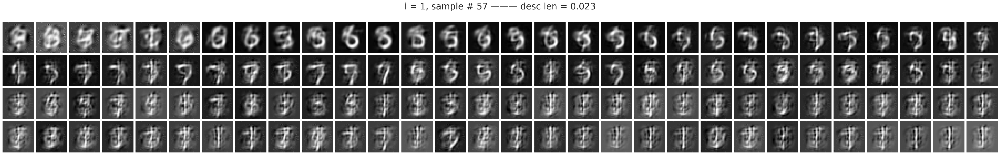

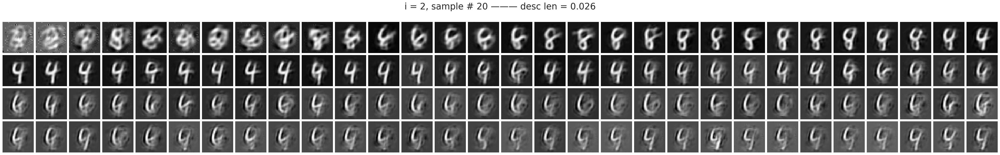

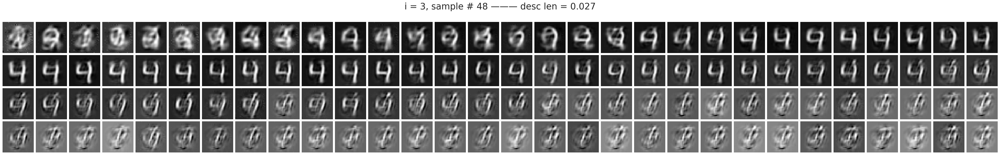

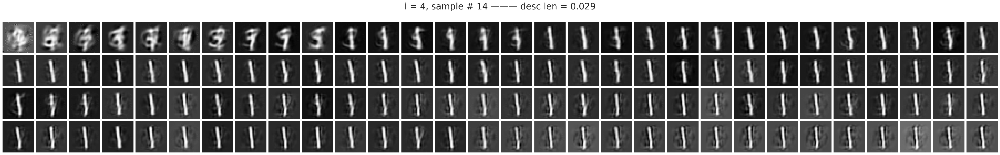

...

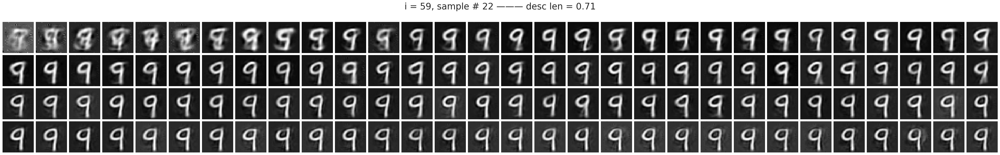

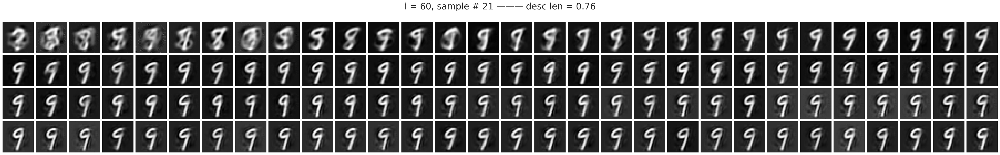

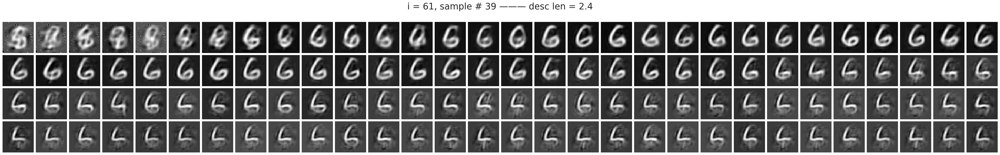

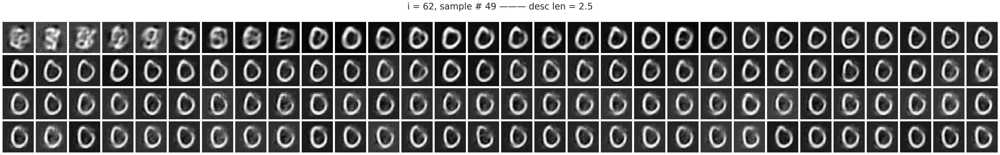

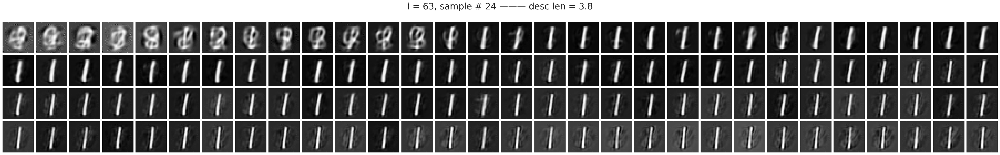

In [22]:
for i in range(len(pred)):
    sample_i = order[i]
    nrows, ncols = 4, 30
    fig, axes = create_figure(nrows, ncols, (1.3 * ncols, 1.3 * nrows), 'all', 'all')
    tit = ' ——— '.join([
        f"i = {i}, sample # {sample_i}",
        f"desc len = {desc_len[sample_i]:0.2g}",
    ])
    fig.suptitle(tit, fontsize=25, y=1.14)
    
    x2p = tonp(pred[sample_i].reshape(shape))
    axes[0, 0].imshow(x2p, cmap='Greys_r')
    
    for idx, ax in enumerate(axes.flat[1:], start=1):
        i, j = idx // ncols, idx % ncols
        x2p = tonp(output['recon'][sample_i, idx - 1].reshape(28, 28))
        ax.imshow(x2p, cmap='Greys_r')
    remove_ticks(axes)
    plt.show()

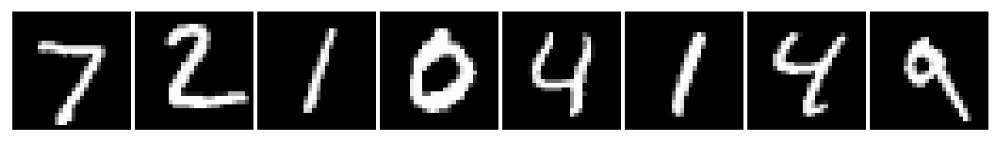

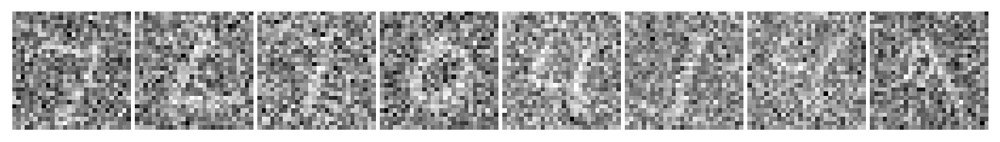

In [71]:
x = next(iter(tr.dl_vld))[0][:8]
x_noisy = x + torch.randn_like(x) * 0.7

_ = plot_weights(tonp(x.squeeze()), nrows=1)
_ = plot_weights(tonp(x_noisy.squeeze()), nrows=1)

In [72]:
tr.model.reset_state(len(x))
tr.model.reset_pred()

output = tr.model(x_noisy, seq=range(300))
output = output.stack()

In [78]:
sample_i = 1

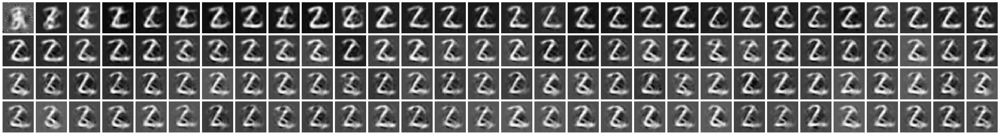

In [79]:
nrows, ncols = 4, 30
fig, axes = create_figure(nrows, ncols, (1.3 * ncols, 1.3 * nrows), 'all', 'all')
for idx, ax in enumerate(axes.flat):
    i, j = idx // ncols, idx % ncols
    x2p = tonp(output['recon'][sample_i, idx].reshape(shape))
    ax.imshow(x2p, cmap='Greys_r')
remove_ticks(axes)

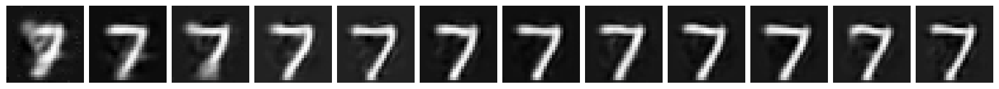

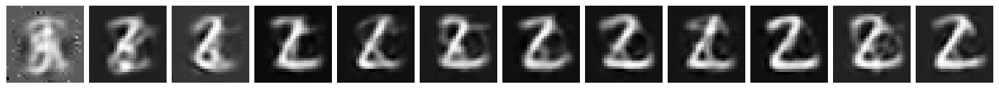

In [80]:
nrows, ncols = 1, 12
fig, axes = create_figure(nrows, ncols, (1.3 * ncols, 1.3 * nrows), 'all', 'all')
for idx, ax in enumerate(axes.flat):
    i, j = idx // ncols, idx % ncols
    x2p = tonp(output['recon'][sample_i, idx].reshape(shape))
    ax.imshow(x2p, cmap='Greys_r')
remove_ticks(axes)